## **MultiRes UNet - Final Version 1**

* Learning rate = 0.0001
* Epochs = 100
* Batch Size = 8

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
# from keras_unet.utils import get_patches
# from keras_unet.models import satellite_unet
import glob
import os
from keras import backend as K 
from keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, BatchNormalization, Activation, add
from keras.models import Model, model_from_json, load_model
import torch
from tensorflow.keras.optimizers import Adam
# from tensorflow import keras
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler, StandardScaler
print(torch.cuda.is_available())

scaler = MinMaxScaler()

%matplotlib inline

True


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Tue May  3 18:07:49 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    26W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


In [ ]:
train_image_paths_list = []
train_gt_paths_list = []
train_image_path = '/content/drive/MyDrive/airs-minisample/patch-png-resize/train_images/train/'
train_label_path = '/content/drive/MyDrive/airs-minisample/patch-png-resize/train_masks/train/'

for img_path in glob.glob(os.path.join(train_image_path, '*.png')):
    train_image_paths_list.append(str(img_path))   
print("Total aerial satellite images : ",len(train_image_paths_list))

for img_path in glob.glob(os.path.join(train_label_path, '*.png')):
    train_gt_paths_list.append(str(img_path))
print("Total segmented mask images : ",len(train_gt_paths_list))

train_image_paths_list.sort()
train_gt_paths_list.sort()

Total aerial satellite images :  1548
Total segmented mask images :  1548


In [ ]:
train_X = []
count = 0
for img in train_image_paths_list:
    img = cv2.imread(img, cv2.IMREAD_COLOR)
    # resized_img = cv2.resize(img,(256, 256), interpolation = cv2.INTER_CUBIC)
    train_X.append(img)

In [ ]:
count = 0
train_Y = []
for img in train_gt_paths_list:
    img = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
    # resized_img = cv2.resize(img,(256, 256), interpolation = cv2.INTER_CUBIC)
    train_Y.append(img)
    
print(len(train_X), len(train_Y))

1548 1548


In [ ]:
val_image_paths_list = []
val_gt_paths_list = []
val_image_path = '/content/drive/MyDrive/airs-minisample/patch-png-resize/val_images/val/'
val_label_path = '/content/drive/MyDrive/airs-minisample/patch-png-resize/val_masks/val/'

for img_path in glob.glob(os.path.join(val_image_path, '*.png')):
    val_image_paths_list.append(str(img_path))        
print("Total aerial images in vaidation set : ",len(val_image_paths_list))

for img_path in glob.glob(os.path.join(val_label_path, '*.png')):
    val_gt_paths_list.append(str(img_path))        
print("Total segmented mask images in validation set : ",len(val_gt_paths_list))

val_image_paths_list.sort()
val_gt_paths_list.sort()

Total aerial images in vaidation set :  36
Total segmented mask images in validation set :  36


In [ ]:
val_X = []
val_Y = []
for img in val_image_paths_list:
    # print(img)
    img = cv2.imread(img, cv2.IMREAD_COLOR)
    # resized_img = cv2.resize(img,(256, 256), interpolation = cv2.INTER_CUBIC)
    val_X.append(img)
    
for img in val_gt_paths_list:
    # print(img)
    img = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
    # resized_img = cv2.resize(img,(256, 256), interpolation = cv2.INTER_CUBIC)
    val_Y.append(img)
    
print(len(val_X), len(val_Y))

36 36


In [5]:
test_image_paths_list = []
test_gt_paths_list = []
test_image_path = '/content/drive/MyDrive/airs-minisample/patch-png-resize/test_images/test/'
test_label_path = '/content/drive/MyDrive/airs-minisample/patch-png-resize/test_masks/test/'

for img_path in glob.glob(os.path.join(test_image_path, '*.png')):
    test_image_paths_list.append(str(img_path))        
print("Total aerial images in test set : ",len(test_image_paths_list))

for img_path in glob.glob(os.path.join(test_label_path, '*.png')):
    test_gt_paths_list.append(str(img_path))        
print("Total segmented mask images in test set : ",len(test_gt_paths_list))

test_image_paths_list.sort()
test_gt_paths_list.sort()

Total aerial images in test set :  144
Total segmented mask images in test set :  144


In [6]:
test_X = []
test_Y = []
for img in test_image_paths_list:
    # print(img)
    img = cv2.imread(img, cv2.IMREAD_COLOR)
    # resized_img = cv2.resize(img,(256, 256), interpolation = cv2.INTER_CUBIC)
    test_X.append(img)
    
for img in test_gt_paths_list:
    # print(img)
    img = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
    # resized_img = cv2.resize(img,(256, 256), interpolation = cv2.INTER_CUBIC)
    test_Y.append(img)
    
print(len(test_X), len(test_Y))

144 144


### **Perform scaling for images using Min Max Scaler**

In [ ]:
train_X = np.array(train_X)
train_Y = np.array(train_Y)

train_Y = train_Y.reshape((train_Y.shape[0],train_Y.shape[1],train_Y.shape[2],1))

train_X_scaler = scaler.fit_transform(train_X.reshape(-1, train_X.shape[-1])).reshape(train_X.shape)
train_Y_scaler = scaler.fit_transform(train_Y.reshape(-1, train_Y.shape[-1])).reshape(train_Y.shape)
print(train_X_scaler.shape, train_Y_scaler.shape)

(1548, 256, 256, 3) (1548, 256, 256, 1)


In [ ]:
val_X = np.array(val_X)
val_Y = np.array(val_Y)

val_Y = val_Y.reshape((val_Y.shape[0],val_Y.shape[1],val_Y.shape[2],1))

val_X = scaler.fit_transform(val_X.reshape(-1, val_X.shape[-1])).reshape(val_X.shape)
val_Y = scaler.fit_transform(val_Y.reshape(-1, val_Y.shape[-1])).reshape(val_Y.shape)
# val_X = val_X / 255.
# val_Y = val_Y / 255.

print(val_X.shape)
print(val_Y.shape)

(36, 256, 256, 3)
(36, 256, 256, 1)


In [7]:
test_X = np.array(test_X)
test_Y = np.array(test_Y)

test_Y = test_Y.reshape((test_Y.shape[0], test_Y.shape[1], test_Y.shape[2],1))

test_X = scaler.fit_transform(test_X.reshape(-1, test_X.shape[-1])).reshape(test_X.shape)
test_Y = scaler.fit_transform(test_Y.reshape(-1, test_Y.shape[-1])).reshape(test_Y.shape)
# val_X = val_X / 255.
# val_Y = val_Y / 255.

print(test_X.shape)
print(test_Y.shape)

(144, 256, 256, 3)
(144, 256, 256, 1)


### **Performance Metrics while training the model**

In [8]:
# def IOU(y_true, y_pred):
#     y_true_f = K.flatten(y_true)
#     y_pred_f = K.flatten(y_pred)
#     intersection = K.sum(y_true_f * y_pred_f)
#     return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection + 1.0)

# def dice_coef(y_true, y_pred):
#     smooth = 0.0
#     y_true_f = K.flatten(y_true)
#     y_pred_f = K.flatten(y_pred)
#     intersection = K.sum(y_true_f * y_pred_f)
#     return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

# def mcc(y_true, y_pred):
#     tp = K.sum(K.cast(y_true*y_pred, 'float'), axis=0)
#     tn = K.sum(K.cast((1-y_true)*(1-y_pred), 'float'), axis=0)
#     fp = K.sum(K.cast((1-y_true)*y_pred, 'float'), axis=0) * 1e2  # needs to be checked
#     fn = K.sum(K.cast(y_true*(1-y_pred), 'float'), axis=0) / 1e2

#     up = tp*tn - fp*fn
#     down = K.sqrt((tp+fp) * (tp+fn) * (tn+fp) * (tn+fn))

#     mcc = up / (down + K.epsilon())
#     mcc = tf.where(tf.math.is_nan(mcc), tf.zeros_like(mcc), mcc)
#     return mcc

In [9]:
def IOU(y_true, y_pred):
  smooth = 1.0
  # y_true = y_true.astype('float32')
  # y_pred = y_pred.astype('float32')
  y_true = tf.cast(y_true, tf.float32)
  y_pred = tf.cast(y_pred, tf.float32)
  y_true_f = K.round(K.flatten(y_true))
  y_pred_f = K.round(K.flatten(y_pred))
  intersection = K.sum(y_true_f * y_pred_f)
  union = K.sum(y_true_f + y_pred_f - y_true_f * y_pred_f)
  # jacc = intersection / (union + K.epsilon())
  jacc = (intersection + smooth) / (union + smooth)
  return jacc

def dice_coef(y_true, y_pred):
    smooth = 1.0
    # y_true = y_true.astype('float32')
    # y_pred = y_pred.astype('float32')
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    y_true_f = K.round(K.flatten(y_true))
    y_pred_f = K.round(K.flatten(y_pred))
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def mcc(y_true, y_pred):
  smooth = 1.0
  # y_true = y_true.astype('float32')
  # y_pred = y_pred.astype('float32')
  y_true = tf.cast(y_true, tf.float32)
  y_pred = tf.cast(y_pred, tf.float32)
  y_true_f = K.round(K.flatten(y_true))
  y_pred_f = K.round(K.flatten(y_pred))
  tp = K.sum(y_true_f * y_pred_f)
  tn = K.sum((1-y_true_f) * (1-y_pred_f))
  fp = K.sum((1-y_true_f)*y_pred_f)
  fn = K.sum(y_true_f * (1-y_pred_f))
  up = tp*tn - fp*fn
  down = K.sqrt((tp+fp) * (tp+fn) * (tn+fp) * (tn+fn))
  mcc = (up + smooth) / (down + smooth)
  return mcc

### **Model defined as per base paper - changed filters from original implementaion of MultiRes**

In [10]:
def conv2d_bn(x, filters, num_row, num_col, padding='same', strides=(1, 1), activation='relu', name=None):
    '''
    2D Convolutional layers
    
    Arguments:
        x {keras layer} -- input layer 
        filters {int} -- number of filters
        num_row {int} -- number of rows in filters
        num_col {int} -- number of columns in filters
    
    Keyword Arguments:
        padding {str} -- mode of padding (default: {'same'})
        strides {tuple} -- stride of convolution operation (default: {(1, 1)})
        activation {str} -- activation function (default: {'relu'})
        name {str} -- name of the layer (default: {None})
    
    Returns:
        [keras layer] -- [output layer]
    '''

    x = Conv2D(filters, (num_row, num_col), strides=strides, padding=padding, use_bias=False)(x)
    x = BatchNormalization(axis=3, scale=False)(x)

    if(activation == None):
        return x

    x = Activation(activation, name=name)(x)

    return x


def trans_conv2d_bn(x, filters, num_row, num_col, padding='same', strides=(2, 2), name=None):
    '''
    2D Transposed Convolutional layers
    
    Arguments:
        x {keras layer} -- input layer 
        filters {int} -- number of filters
        num_row {int} -- number of rows in filters
        num_col {int} -- number of columns in filters
    
    Keyword Arguments:
        padding {str} -- mode of padding (default: {'same'})
        strides {tuple} -- stride of convolution operation (default: {(2, 2)})
        name {str} -- name of the layer (default: {None})
    
    Returns:
        [keras layer] -- [output layer]
    '''

    x = Conv2DTranspose(filters, (num_row, num_col), strides=strides, padding=padding)(x)
    x = BatchNormalization(axis=3, scale=False)(x)
    
    return x


def MultiResBlock(U, inp, alpha = 1.67):

    W = alpha * U

    shortcut = inp

    shortcut = conv2d_bn(shortcut, int(W*0.167) + int(W*0.333) +
                         int(W*0.5), 1, 1, activation=None, padding='same')

    conv3x3 = conv2d_bn(inp, int(W*0.167), 3, 3,
                        activation='relu', padding='same')

    conv5x5 = conv2d_bn(conv3x3, int(W*0.333), 3, 3,
                        activation='relu', padding='same')

    conv7x7 = conv2d_bn(conv5x5, int(W*0.5), 3, 3,
                        activation='relu', padding='same')

    out = concatenate([conv3x3, conv5x5, conv7x7], axis=3)
    out = BatchNormalization(axis=3)(out)

    out = add([shortcut, out])
    out = Activation('relu')(out)
    out = BatchNormalization(axis=3)(out)

    return out


def ResPath(filters, length, inp):

    shortcut = inp
    shortcut = conv2d_bn(shortcut, filters, 1, 1,
                         activation=None, padding='same')

    out = conv2d_bn(inp, filters, 3, 3, activation='relu', padding='same')

    out = add([shortcut, out])
    out = Activation('relu')(out)
    out = BatchNormalization(axis=3)(out)

    for i in range(length-1):

        shortcut = out
        shortcut = conv2d_bn(shortcut, filters, 1, 1,
                             activation=None, padding='same')

        out = conv2d_bn(out, filters, 3, 3, activation='relu', padding='same')

        out = add([shortcut, out])
        out = Activation('relu')(out)
        out = BatchNormalization(axis=3)(out)

    return out


def MultiResUnetBP(height, width, n_channels):

    inputs = Input((height, width, n_channels))

    mresblock1 = MultiResBlock(32, inputs)
    pool1 = MaxPooling2D(pool_size=(2, 2))(mresblock1)
    mresblock1 = ResPath(32*2, 4, mresblock1)

    mresblock2 = MultiResBlock(32*2, pool1)
    pool2 = MaxPooling2D(pool_size=(2, 2))(mresblock2)
    mresblock2 = ResPath(32*4, 3, mresblock2)

    mresblock3 = MultiResBlock(32*4, pool2)
    pool3 = MaxPooling2D(pool_size=(2, 2))(mresblock3)
    mresblock3 = ResPath(32*8, 2, mresblock3)

    mresblock4 = MultiResBlock(32*8, pool3)
    pool4 = MaxPooling2D(pool_size=(2, 2))(mresblock4)
    mresblock4 = ResPath(32*16, 1, mresblock4)

    mresblock5 = MultiResBlock(32*16, pool4)

    up6 = concatenate([Conv2DTranspose(
        32*8, (2, 2), strides=(2, 2), padding='same')(mresblock5), mresblock4], axis=3)
    mresblock6 = MultiResBlock(32*8, up6)

    up7 = concatenate([Conv2DTranspose(
        32*4, (2, 2), strides=(2, 2), padding='same')(mresblock6), mresblock3], axis=3)
    mresblock7 = MultiResBlock(32*4, up7)

    up8 = concatenate([Conv2DTranspose(
        32*2, (2, 2), strides=(2, 2), padding='same')(mresblock7), mresblock2], axis=3)
    mresblock8 = MultiResBlock(32*2, up8)

    up9 = concatenate([Conv2DTranspose(32, (2, 2), strides=(
        2, 2), padding='same')(mresblock8), mresblock1], axis=3)
    mresblock9 = MultiResBlock(32, up9)

    conv10 = conv2d_bn(mresblock9, 1, 1, 1, activation='sigmoid')
    
    MultiResModel = Model(inputs=[inputs], outputs=[conv10])

    return MultiResModel

In [ ]:
MultiResModel = MultiResUnetBP(height=256, width=256, n_channels=3)
MultiResModel.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 256, 256, 8)  216         ['input_1[0][0]']                
                                                                                                  
 batch_normalization_1 (BatchNo  (None, 256, 256, 8)  24         ['conv2d_1[0][0]']               
 rmalization)                                                                                     
                                                                                              

In [ ]:
MultiResModel.compile(optimizer = Adam(learning_rate = 0.0001), loss = 'binary_crossentropy', metrics = [IOU, mcc, dice_coef, 'accuracy'], run_eagerly = True)

In [ ]:
# Need to check how to store values for each epochs as JSON (callbacks should store all performance metrics and loss for each epoch)
history = MultiResModel.fit(x = train_X_scaler, y = train_Y_scaler, validation_data = (val_X, val_Y), batch_size = 8, epochs = 100, verbose = 1)

Epoch 1/100
194/194 [==============================] - 122s 565ms/step - loss: 0.5744 - IOU: 0.4068 - mcc: 0.5037 - dice_coef: 0.5640 - accuracy: 0.8175 - val_loss: 0.6159 - val_IOU: 1.7625e-04 - val_mcc: 0.6060 - val_dice_coef: 3.4350e-04 - val_accuracy: 0.7375
Epoch 2/100
194/194 [==============================] - 108s 558ms/step - loss: 0.5270 - IOU: 0.5270 - mcc: 0.6392 - dice_coef: 0.6769 - accuracy: 0.8846 - val_loss: 0.5904 - val_IOU: 0.0857 - val_mcc: 0.2378 - val_dice_coef: 0.1578 - val_accuracy: 0.7580
Epoch 3/100
194/194 [==============================] - 108s 558ms/step - loss: 0.5069 - IOU: 0.5804 - mcc: 0.6911 - dice_coef: 0.7233 - accuracy: 0.9070 - val_loss: 0.4837 - val_IOU: 0.6731 - val_mcc: 0.7362 - val_dice_coef: 0.8046 - val_accuracy: 0.8792
Epoch 4/100
194/194 [==============================] - 108s 559ms/step - loss: 0.4929 - IOU: 0.6194 - mcc: 0.7254 - dice_coef: 0.7555 - accuracy: 0.9200 - val_loss: 0.4585 - val_IOU: 0.7234 - val_mcc: 0.7842 - val_dice_coef: 0.

In [ ]:
MultiResModel.save_weights('/content/drive/MyDrive/airs-minisample/weights/multires-resize-1500images-bp-100epochs.h5')
MultiResModel.save_weights('/content/drive/MyDrive/airs-minisample/weights/multires-resize-1500images-bp-100epochs.tf')

### **Graph**

In [ ]:
history

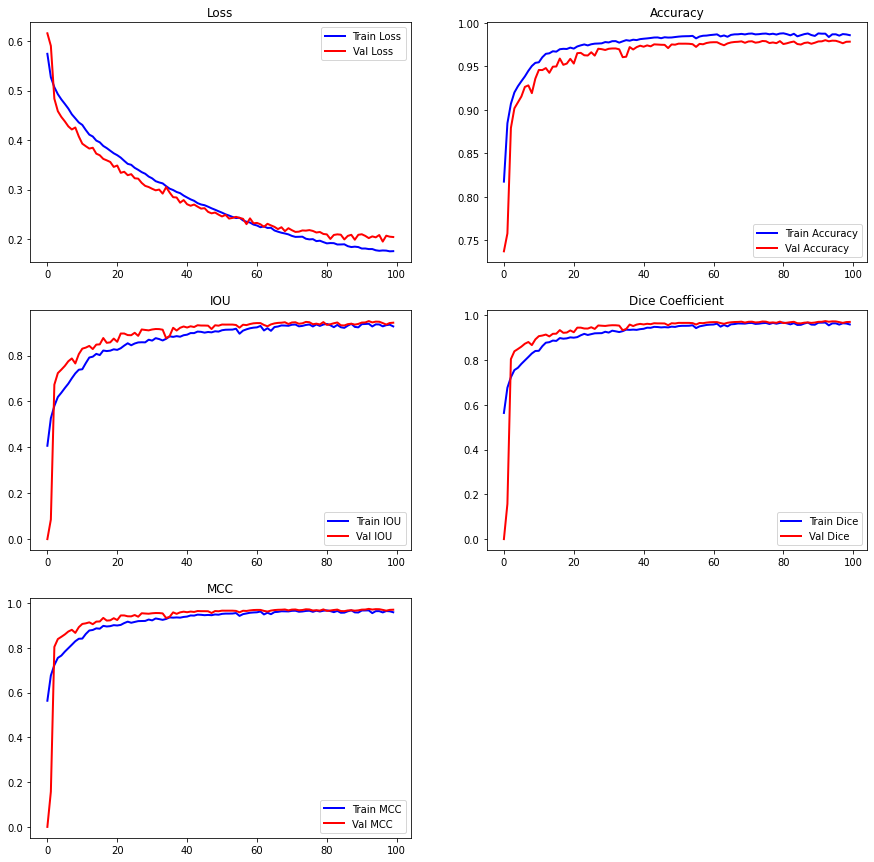

In [ ]:
epoch_loss = history.history['loss']
epoch_val_loss = history.history['val_loss']
epoch_acc = history.history['accuracy']
epoch_val_acc = history.history['val_accuracy']
epoch_jac = history.history['IOU']
epoch_val_jac = history.history['val_IOU']
epoch_dice = history.history['dice_coef']
epoch_val_dice = history.history['val_dice_coef']
epoch_mcc = history.history['mcc']
epoch_val_mcc = history.history['val_mcc']

# plt.figure(figsize=(20,6))
fig = plt.figure(figsize=(15,15))
plt.subplot(3,2,1)
plt.plot(range(0,len(epoch_loss)), epoch_loss, 'b-', linewidth=2, label='Train Loss')
plt.plot(range(0,len(epoch_val_loss)), epoch_val_loss, 'r-', linewidth=2, label='Val Loss')
plt.title('Loss')
plt.legend(loc='best')

plt.subplot(3,2,2)
plt.plot(range(0,len(epoch_acc)), epoch_acc, 'b-', linewidth=2, label='Train Accuracy')
plt.plot(range(0,len(epoch_val_acc)), epoch_val_acc, 'r-', linewidth=2, label='Val Accuracy')
plt.title('Accuracy')
plt.legend(loc='best')

plt.subplot(3,2,3)
plt.plot(range(0,len(epoch_jac)), epoch_jac, 'b-', linewidth=2, label='Train IOU')
plt.plot(range(0,len(epoch_val_jac)), epoch_val_jac, 'r-', linewidth=2, label='Val IOU')
plt.title('IOU')
plt.legend(loc='best')

plt.subplot(3,2,4)
plt.plot(range(0,len(epoch_dice)), epoch_dice, 'b-', linewidth=2, label='Train Dice')
plt.plot(range(0,len(epoch_val_dice)), epoch_val_dice, 'r-', linewidth=2, label='Val Dice')
plt.title('Dice Coefficient')
plt.legend(loc='best')

plt.subplot(3,2,5)
plt.plot(range(0,len(epoch_mcc)), epoch_dice, 'b-', linewidth=2, label='Train MCC')
plt.plot(range(0,len(epoch_val_mcc)), epoch_val_dice, 'r-', linewidth=2, label='Val MCC')
plt.title('MCC')
plt.legend(loc='best')

plt.show()

### **Prediction on val image**

Image number: 0
IOU Score: 0.9552971124649048 
Dice Coefficent: 0.9771369099617004 
MCC: 0.9683483839035034


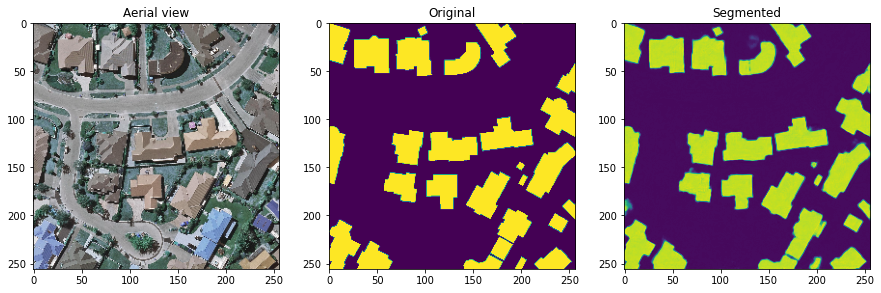

Image number: 1
IOU Score: 0.9392071962356567 
Dice Coefficent: 0.968649685382843 
MCC: 0.9593626260757446


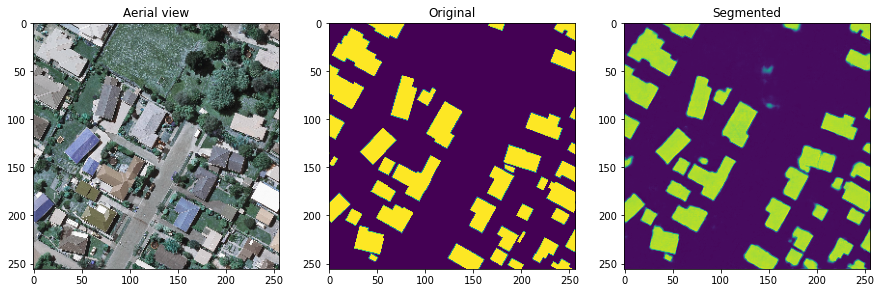

Image number: 2
IOU Score: 0.938090980052948 
Dice Coefficent: 0.9680556654930115 
MCC: 0.9586325883865356


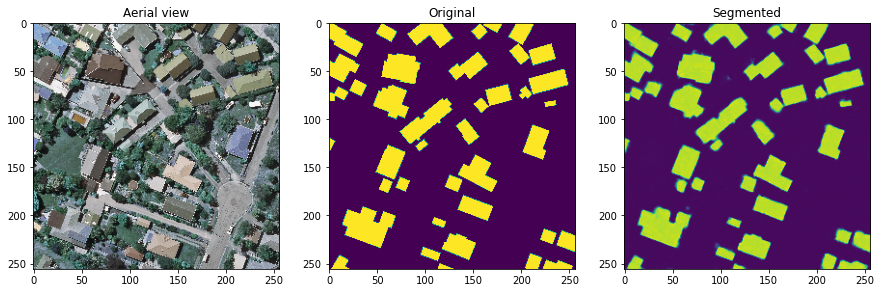

Image number: 3
IOU Score: 0.9380468130111694 
Dice Coefficent: 0.9680318832397461 
MCC: 0.9608235955238342


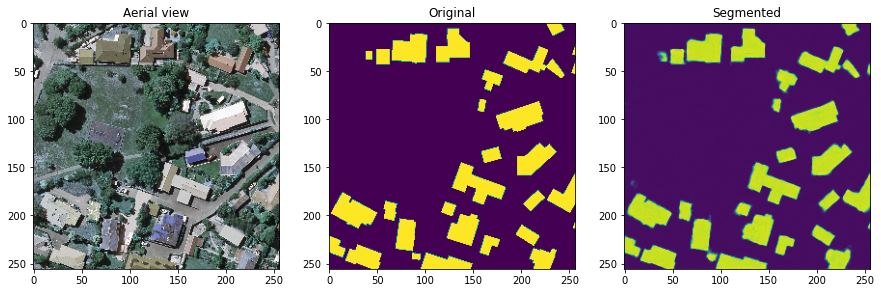

Image number: 4
IOU Score: 0.9394270181655884 
Dice Coefficent: 0.9687665104866028 
MCC: 0.960300624370575


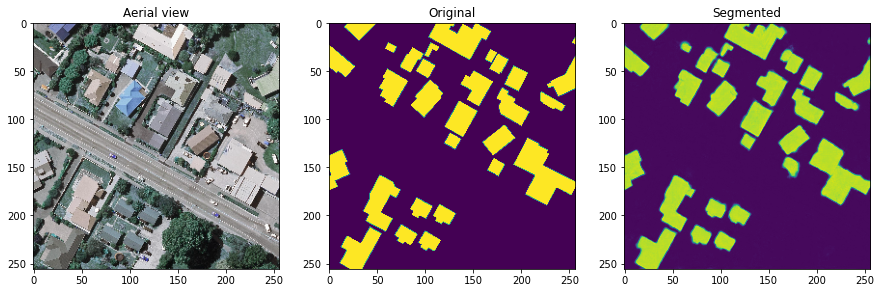

Image number: 5
IOU Score: 0.941710889339447 
Dice Coefficent: 0.9699795246124268 
MCC: 0.9615489840507507


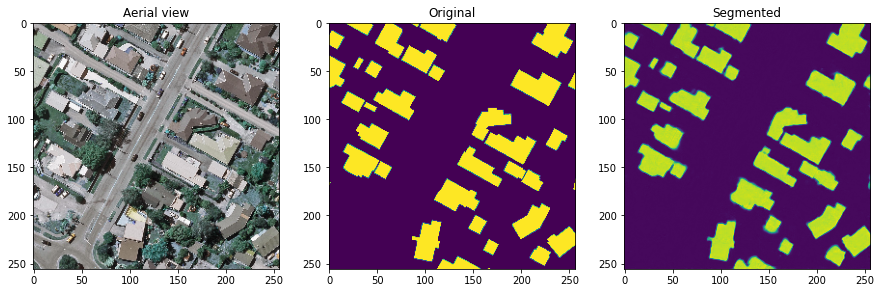

Image number: 6
IOU Score: 0.9425788521766663 
Dice Coefficent: 0.9704399108886719 
MCC: 0.959526002407074


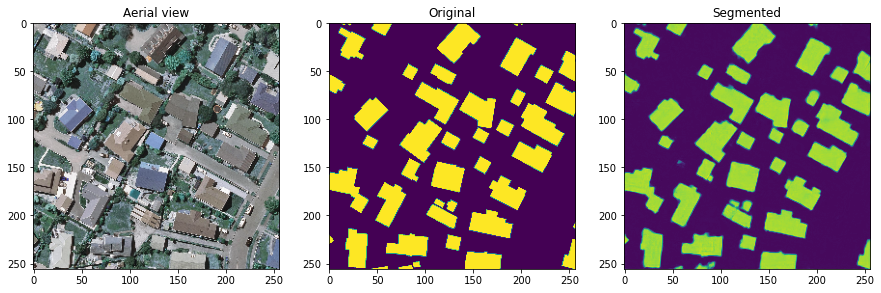

Image number: 7
IOU Score: 0.9377930760383606 
Dice Coefficent: 0.9678972363471985 
MCC: 0.954727828502655


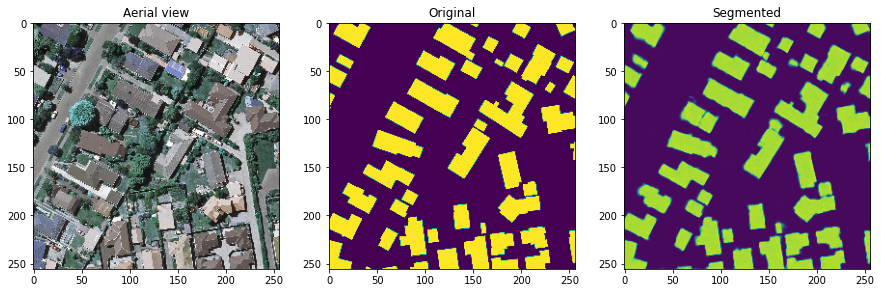

Image number: 8
IOU Score: 0.9502307772636414 
Dice Coefficent: 0.9744795560836792 
MCC: 0.9661412239074707


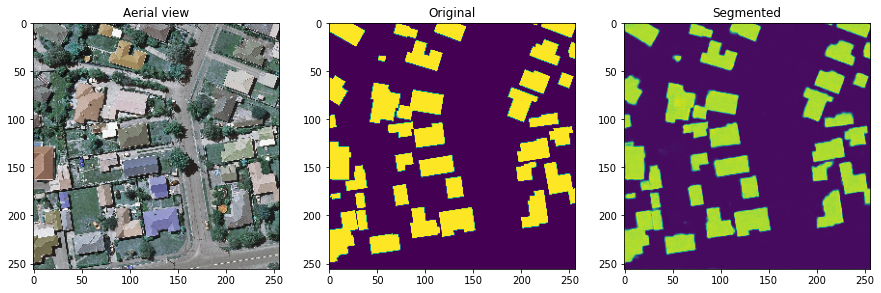

Image number: 9
IOU Score: 0.9356167316436768 
Dice Coefficent: 0.966736376285553 
MCC: 0.9583919644355774


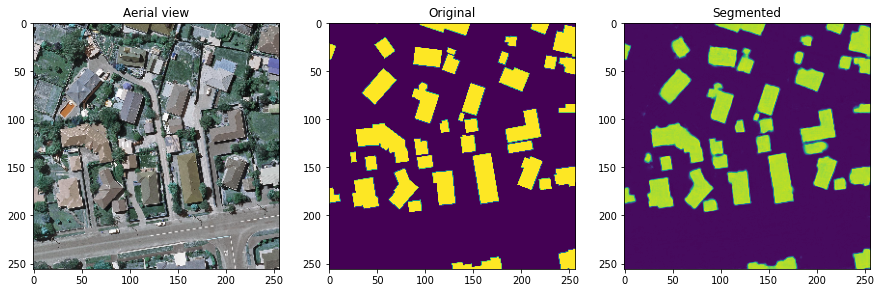

Image number: 10
IOU Score: 0.9497025012969971 
Dice Coefficent: 0.9742016196250916 
MCC: 0.9663147926330566


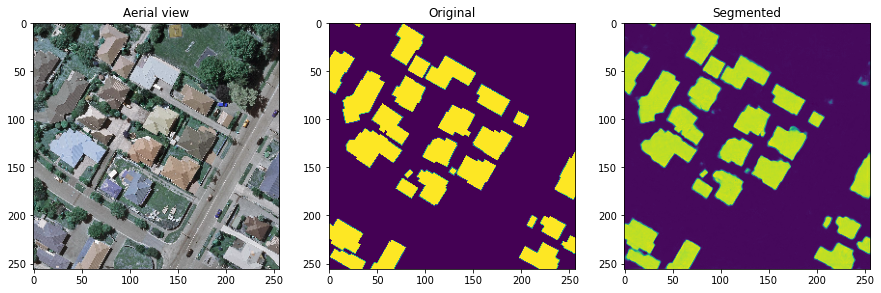

Image number: 11
IOU Score: 0.9472543001174927 
Dice Coefficent: 0.9729118943214417 
MCC: 0.9648376703262329


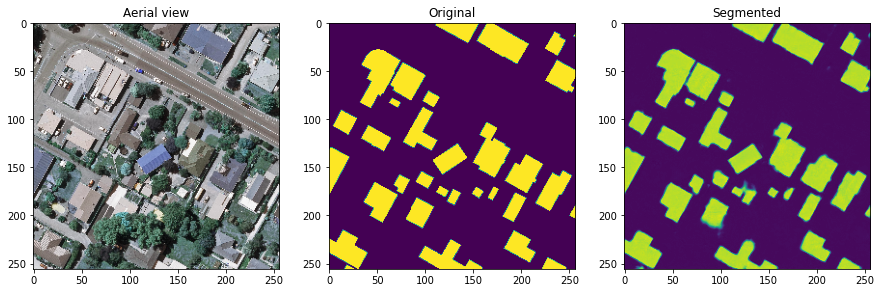

Image number: 12
IOU Score: 0.9376665949821472 
Dice Coefficent: 0.967829704284668 
MCC: 0.9576146006584167


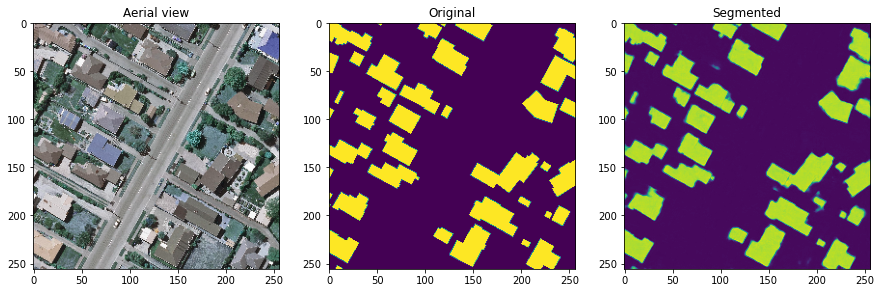

Image number: 13
IOU Score: 0.9322354793548584 
Dice Coefficent: 0.964928150177002 
MCC: 0.956454336643219


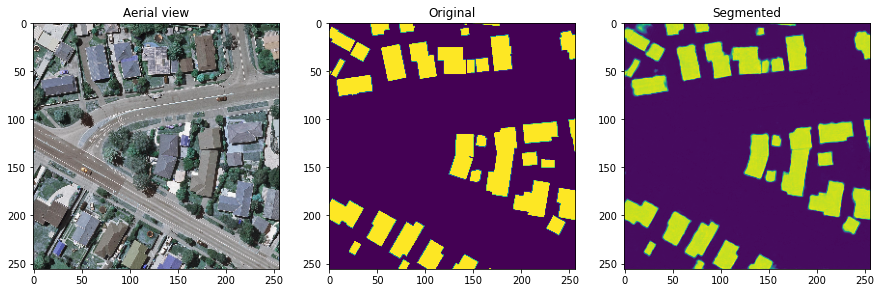

Image number: 14
IOU Score: 0.9409893155097961 
Dice Coefficent: 0.9695966839790344 
MCC: 0.959488034248352


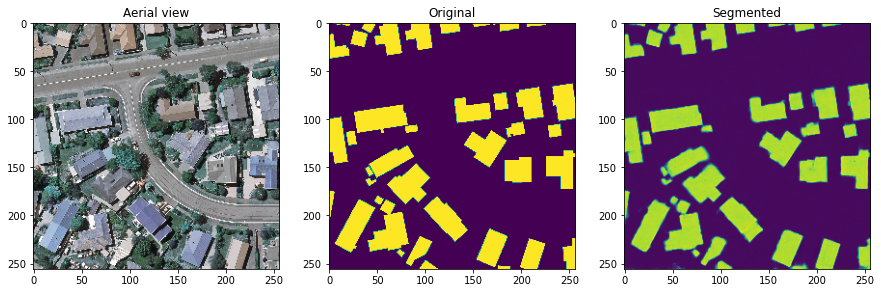

Image number: 15
IOU Score: 0.9467764496803284 
Dice Coefficent: 0.9726598858833313 
MCC: 0.9635068774223328


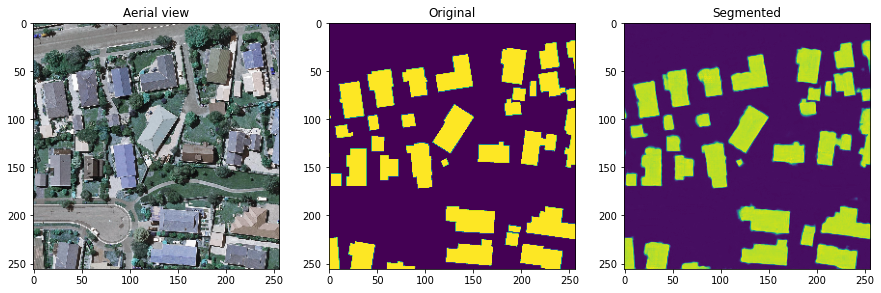

Image number: 16
IOU Score: 0.9493854641914368 
Dice Coefficent: 0.9740349054336548 
MCC: 0.9648867249488831


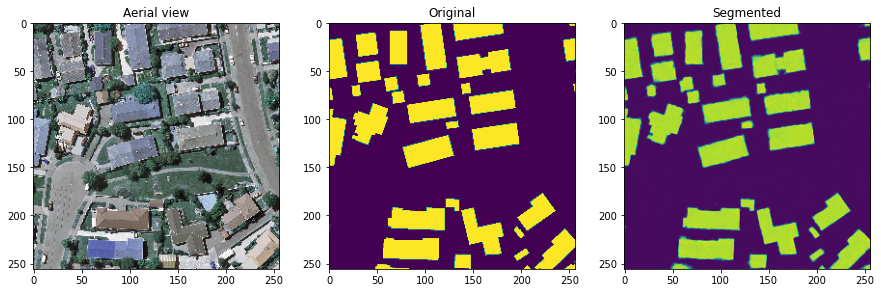

Image number: 17
IOU Score: 0.9459475874900818 
Dice Coefficent: 0.9722222089767456 
MCC: 0.9634881019592285


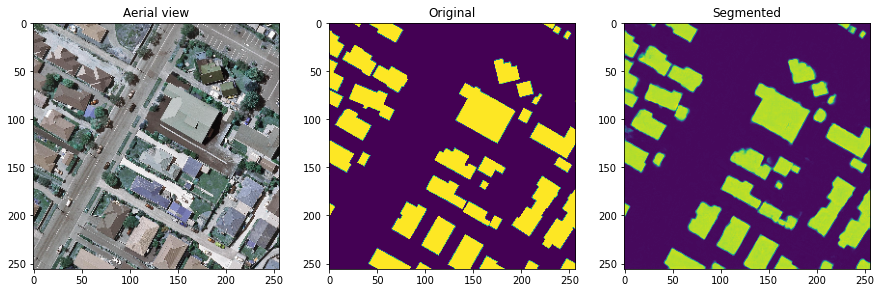

Image number: 18
IOU Score: 0.9499887824058533 
Dice Coefficent: 0.9743523597717285 
MCC: 0.9651668667793274


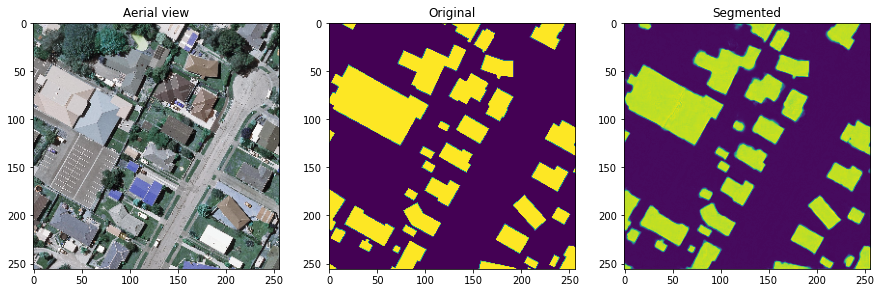

Image number: 19
IOU Score: 0.9439914226531982 
Dice Coefficent: 0.9711880087852478 
MCC: 0.9618372321128845


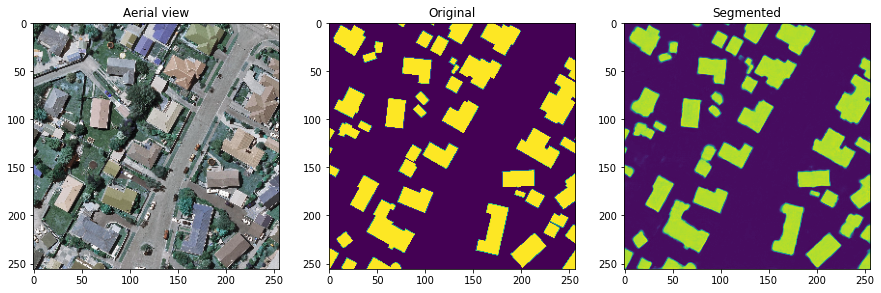

Image number: 20
IOU Score: 0.9392892122268677 
Dice Coefficent: 0.9686934351921082 
MCC: 0.9574030637741089


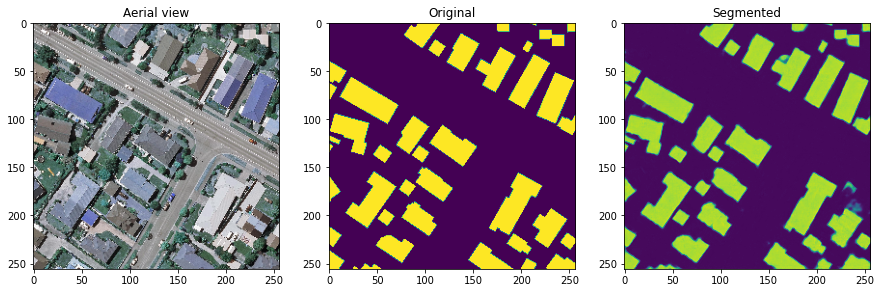

Image number: 21
IOU Score: 0.9454127550125122 
Dice Coefficent: 0.9719398021697998 
MCC: 0.9607241153717041


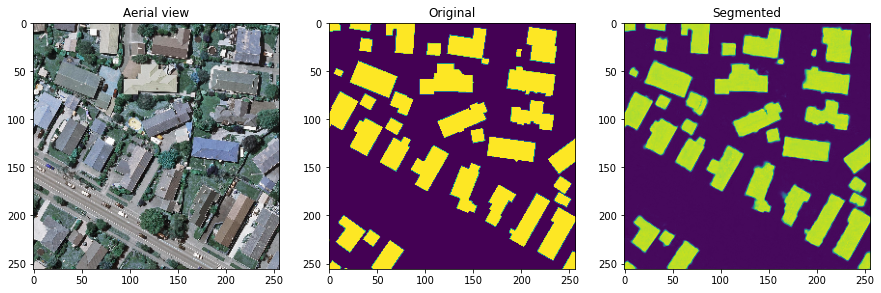

Image number: 22
IOU Score: 0.9519890546798706 
Dice Coefficent: 0.975403368473053 
MCC: 0.9664713740348816


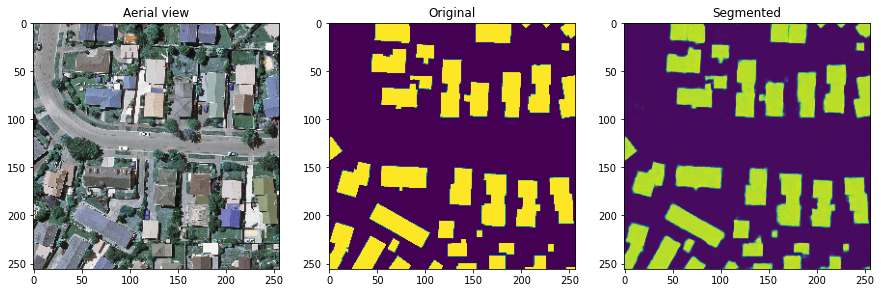

Image number: 23
IOU Score: 0.9358968138694763 
Dice Coefficent: 0.9668862819671631 
MCC: 0.951704740524292


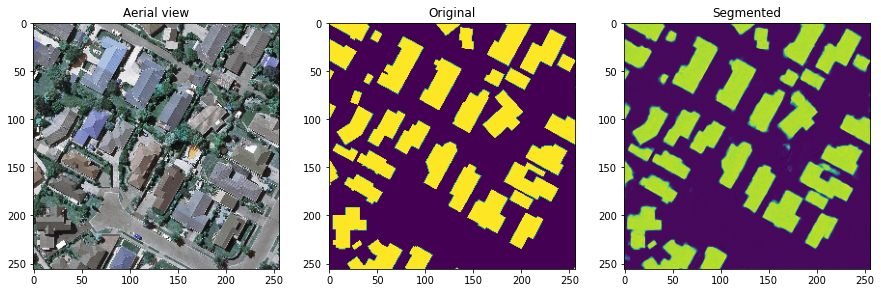

Image number: 24
IOU Score: 0.939833402633667 
Dice Coefficent: 0.9689826965332031 
MCC: 0.9586437344551086


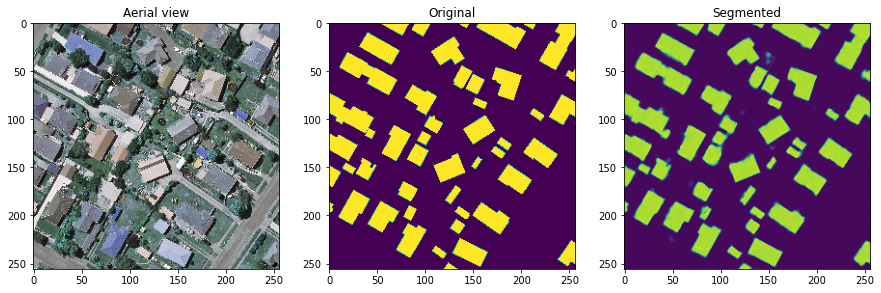

Image number: 25
IOU Score: 0.9402501583099365 
Dice Coefficent: 0.9692039489746094 
MCC: 0.9616079330444336


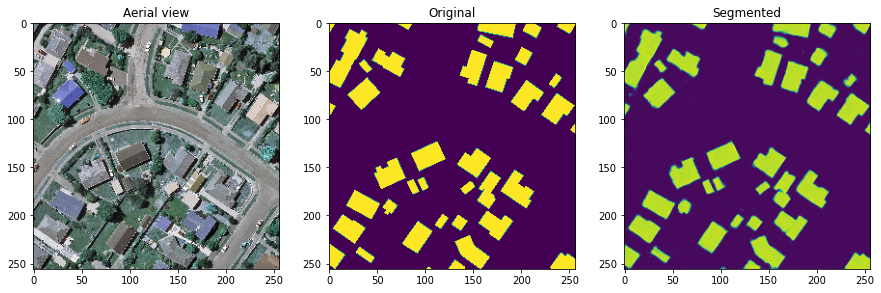

Image number: 26
IOU Score: 0.9341234564781189 
Dice Coefficent: 0.9659388661384583 
MCC: 0.9543179273605347


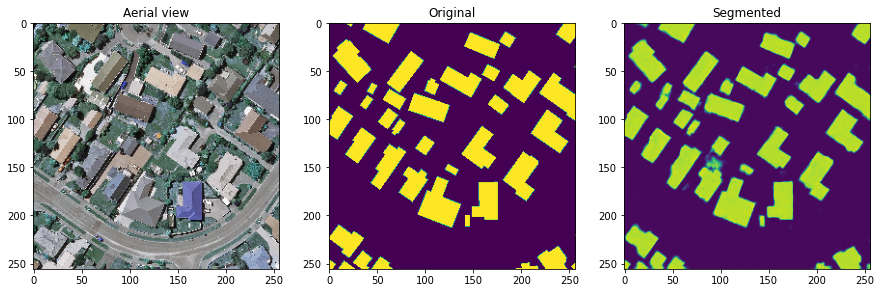

Image number: 27
IOU Score: 0.953183650970459 
Dice Coefficent: 0.9760300517082214 
MCC: 0.9674212336540222


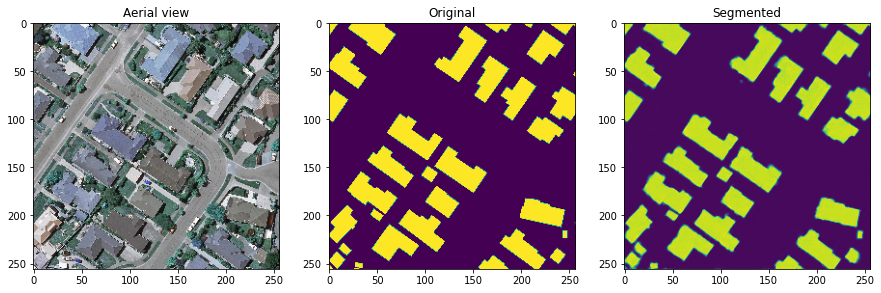

Image number: 28
IOU Score: 0.9458569884300232 
Dice Coefficent: 0.9721745252609253 
MCC: 0.9596988558769226


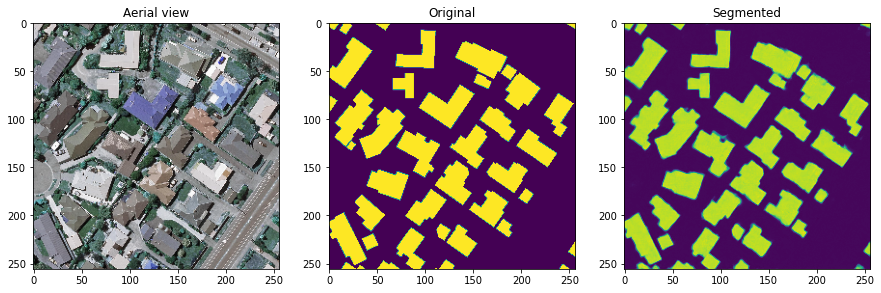

Image number: 29
IOU Score: 0.9507560729980469 
Dice Coefficent: 0.9747556447982788 
MCC: 0.9675284624099731


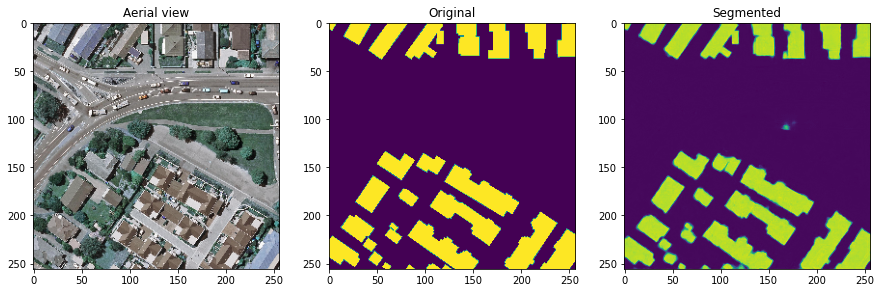

Image number: 30
IOU Score: 0.9404729008674622 
Dice Coefficent: 0.9693225026130676 
MCC: 0.958466112613678


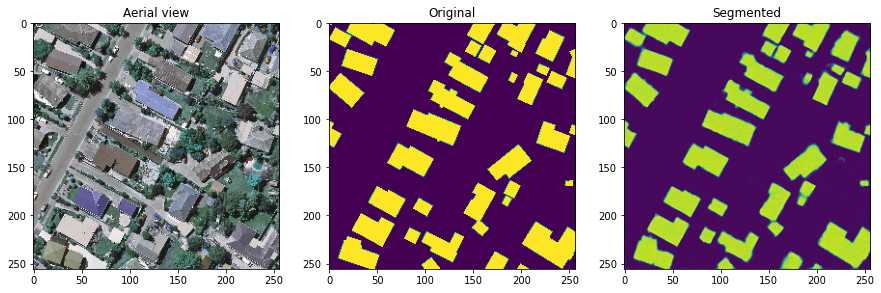

Image number: 31
IOU Score: 0.9396142959594727 
Dice Coefficent: 0.9688661098480225 
MCC: 0.9598971605300903


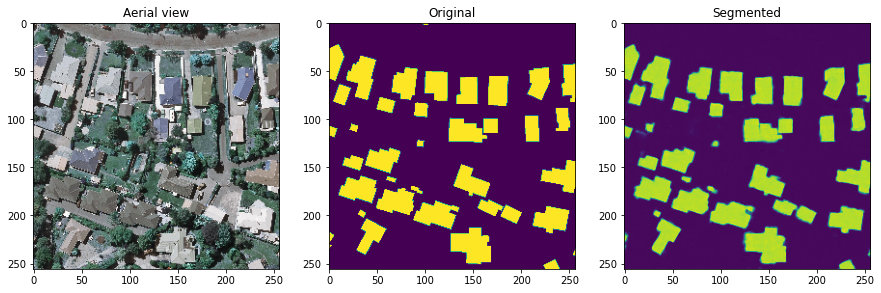

Image number: 32
IOU Score: 0.9442782402038574 
Dice Coefficent: 0.9713398814201355 
MCC: 0.9597562551498413


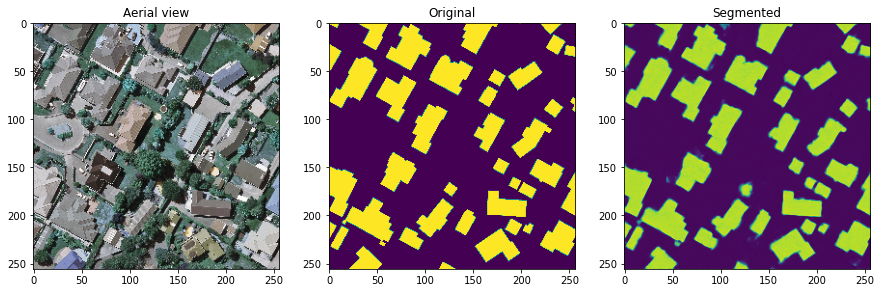

Image number: 33
IOU Score: 0.9400302767753601 
Dice Coefficent: 0.9690873026847839 
MCC: 0.9592264294624329


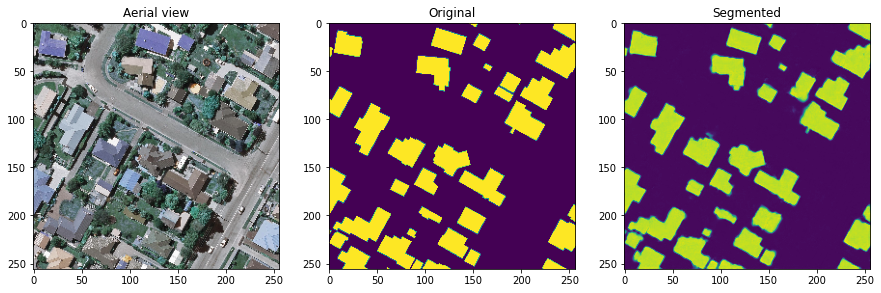

Image number: 34
IOU Score: 0.9486427903175354 
Dice Coefficent: 0.9736438989639282 
MCC: 0.9638797044754028


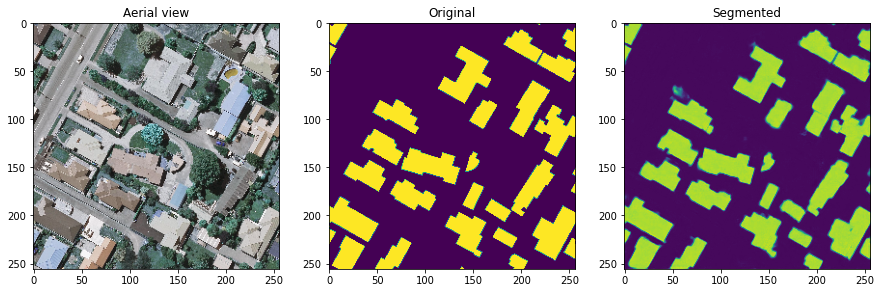

Image number: 35
IOU Score: 0.9354921579360962 
Dice Coefficent: 0.9666702151298523 
MCC: 0.9533882737159729


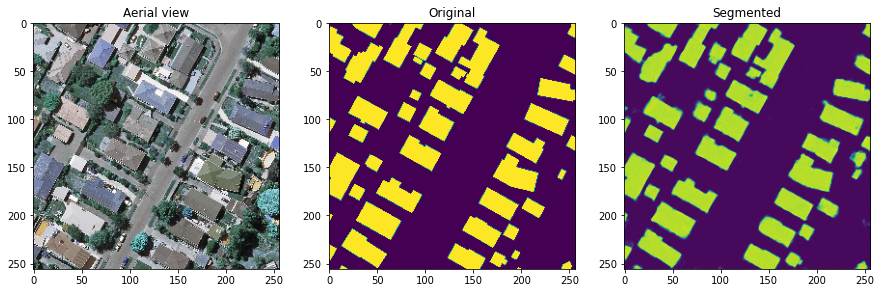

In [ ]:
rows = 36
columns = 3
count = 1
for image_number in range(0,36):

  fig = plt.figure(figsize=(15,15))
  print('Image number: {0}'.format(image_number))
  pred_y = MultiResModel.predict(val_X[image_number:image_number+1])
  # pred_y = pred_y / 255.
  # pred_y = scaler.fit_transform(pred_y.reshape(-1, pred_y.shape[-1])).reshape(pred_y.shape)

  fig.add_subplot(rows, columns, count)
  plt.subplot(1,3,1)
  plt.imshow(np.squeeze(val_X[image_number:image_number+1]))
  plt.title('Aerial view')

  fig.add_subplot(rows, columns, count+1)
  plt.subplot(1,3,2)
  plt.imshow(np.squeeze(val_Y[image_number:image_number+1]))
  plt.title('Original')

  fig.add_subplot(rows, columns, count+2)
  plt.subplot(1,3,3)
  plt.imshow(np.squeeze(pred_y[0]))
  plt.title('Segmented')
  count += 3

  print("IOU Score: {0} \nDice Coefficent: {1} \nMCC: {2}".format(IOU(val_Y[image_number:image_number+1], pred_y), dice_coef(val_Y[image_number:image_number+1], pred_y), mcc(val_Y[image_number:image_number+1], pred_y)))

  plt.show()

### **Loading weights and testing**

In [11]:
MultiResModel_test = MultiResUnetBP(height=256, width=256, n_channels=3)
MultiResModel_test.load_weights('/content/drive/MyDrive/airs-minisample/weights/multires-resize-1500images-bp-100epochs.tf')

Image number: 0
IOU Score: 0.9552971124649048 
Dice Coefficent: 0.9771369099617004 
MCC: 0.9683483839035034


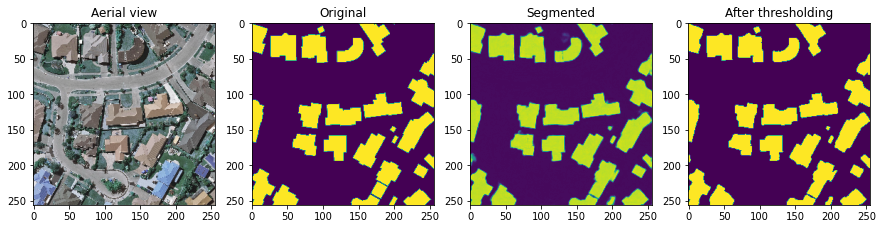

Image number: 1
IOU Score: 0.9392071962356567 
Dice Coefficent: 0.968649685382843 
MCC: 0.9593626260757446


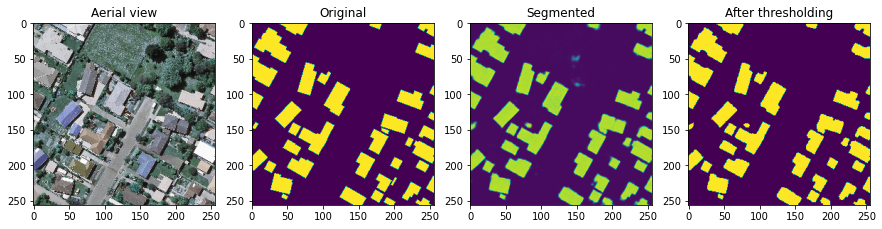

Image number: 2
IOU Score: 0.938090980052948 
Dice Coefficent: 0.9680556654930115 
MCC: 0.9586325883865356


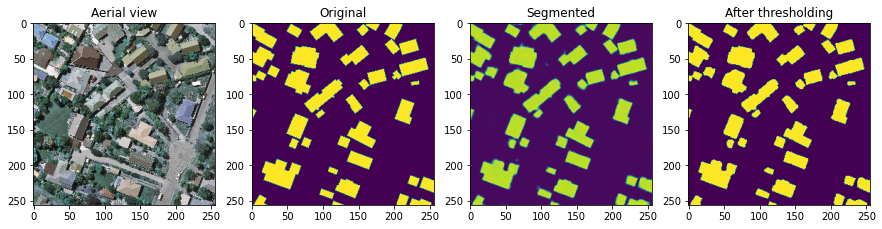

Image number: 3
IOU Score: 0.9380468130111694 
Dice Coefficent: 0.9680318832397461 
MCC: 0.9608235955238342


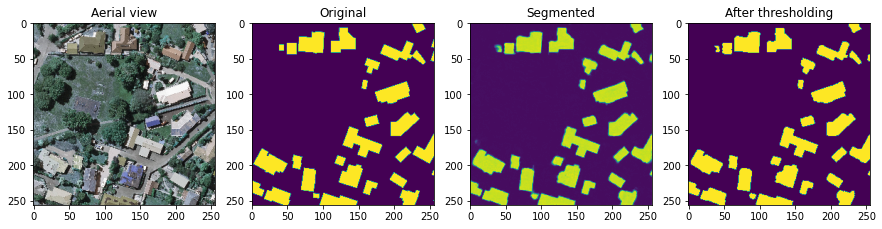

Image number: 4
IOU Score: 0.9394270181655884 
Dice Coefficent: 0.9687665104866028 
MCC: 0.960300624370575


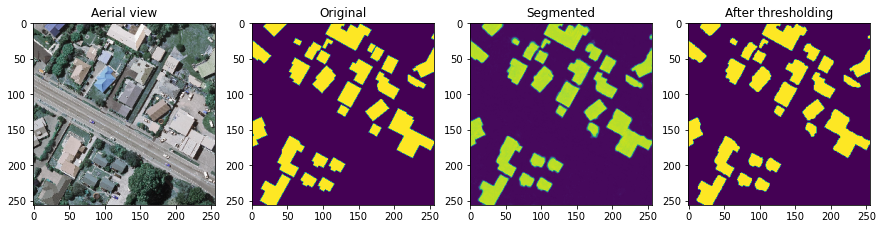

Image number: 5
IOU Score: 0.941710889339447 
Dice Coefficent: 0.9699795246124268 
MCC: 0.9615489840507507


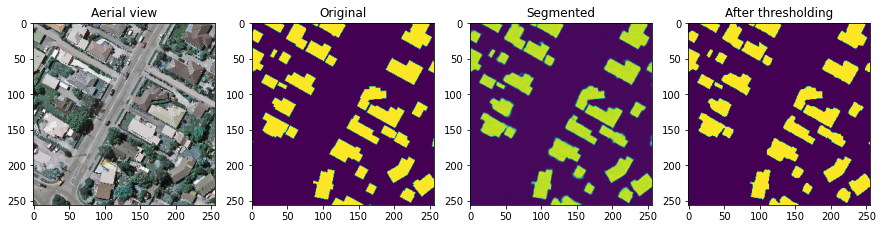

Image number: 6
IOU Score: 0.9425788521766663 
Dice Coefficent: 0.9704399108886719 
MCC: 0.959526002407074


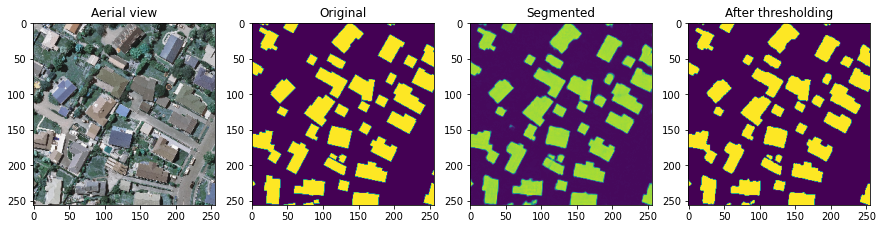

Image number: 7
IOU Score: 0.9377930760383606 
Dice Coefficent: 0.9678972363471985 
MCC: 0.954727828502655


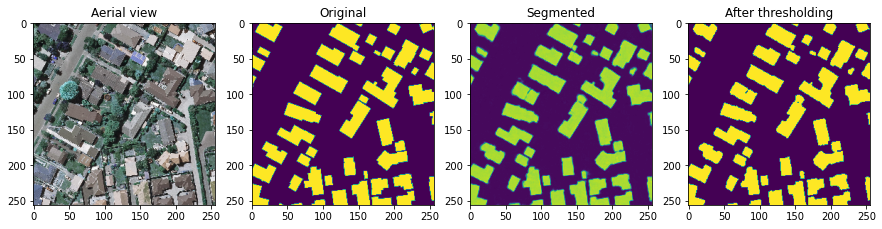

Image number: 8
IOU Score: 0.9502307772636414 
Dice Coefficent: 0.9744795560836792 
MCC: 0.9661412239074707


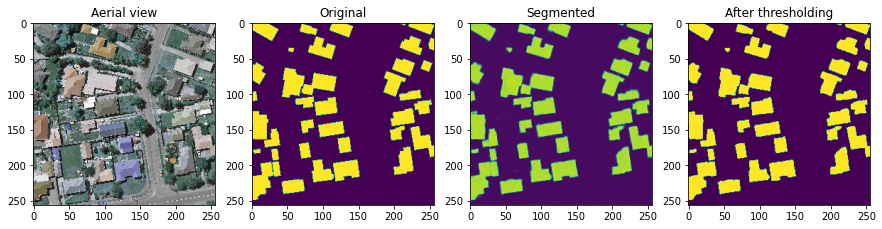

Image number: 9
IOU Score: 0.9356167316436768 
Dice Coefficent: 0.966736376285553 
MCC: 0.9583919644355774


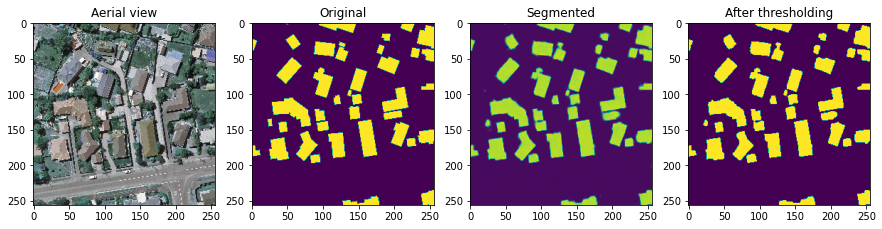

Image number: 10
IOU Score: 0.9497025012969971 
Dice Coefficent: 0.9742016196250916 
MCC: 0.9663147926330566


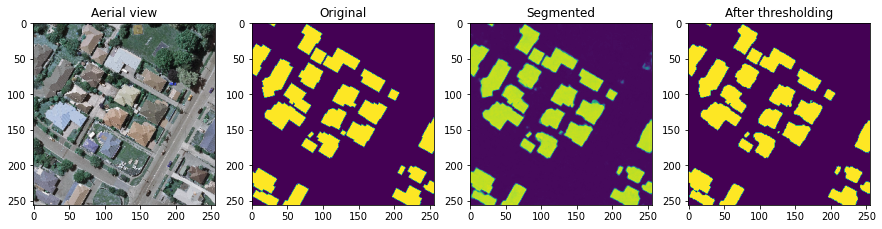

Image number: 11
IOU Score: 0.9472543001174927 
Dice Coefficent: 0.9729118943214417 
MCC: 0.9648376703262329


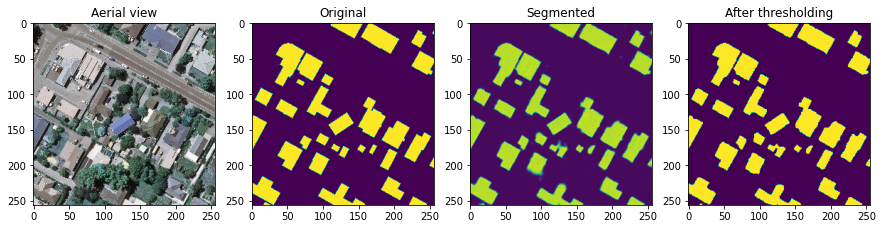

Image number: 12
IOU Score: 0.9376665949821472 
Dice Coefficent: 0.967829704284668 
MCC: 0.9576146006584167


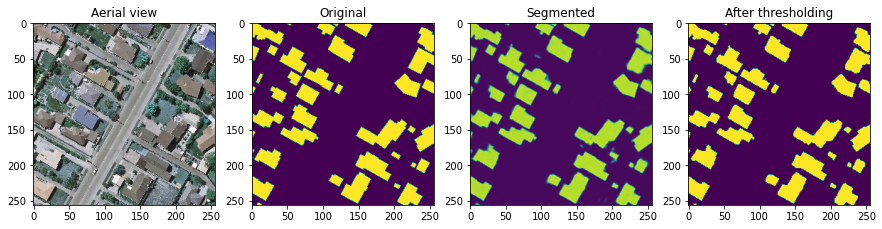

Image number: 13
IOU Score: 0.9322354793548584 
Dice Coefficent: 0.964928150177002 
MCC: 0.956454336643219


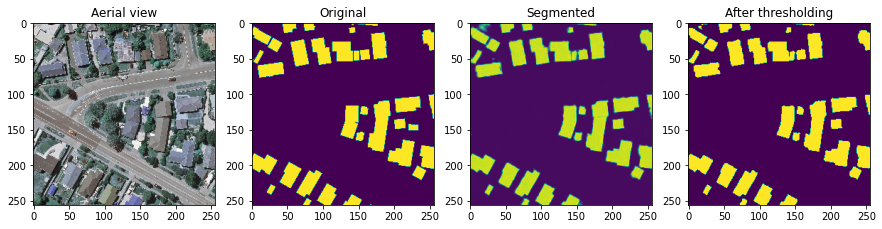

Image number: 14
IOU Score: 0.9409893155097961 
Dice Coefficent: 0.9695966839790344 
MCC: 0.959488034248352


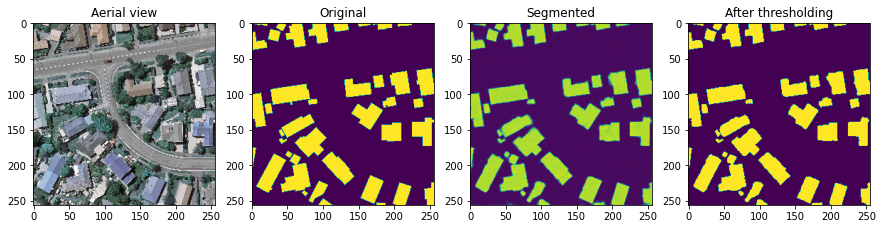

Image number: 15
IOU Score: 0.9467764496803284 
Dice Coefficent: 0.9726598858833313 
MCC: 0.9635068774223328


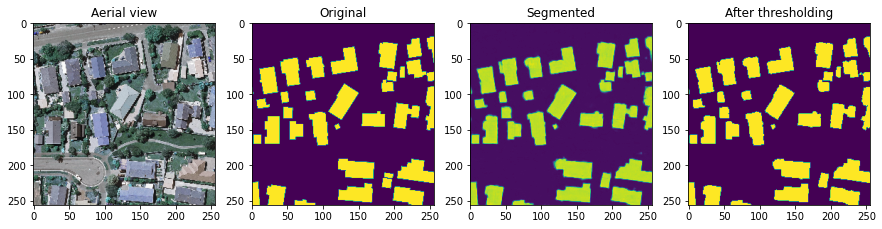

Image number: 16
IOU Score: 0.9493854641914368 
Dice Coefficent: 0.9740349054336548 
MCC: 0.9648867249488831


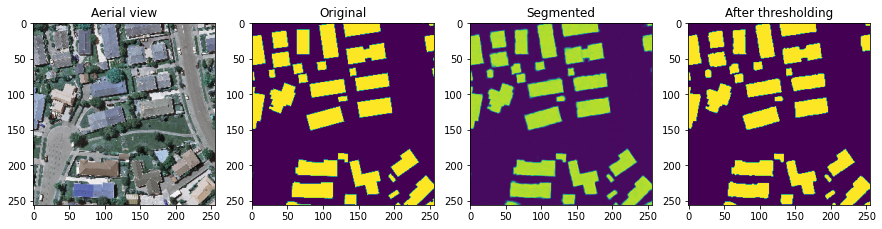

Image number: 17
IOU Score: 0.9459475874900818 
Dice Coefficent: 0.9722222089767456 
MCC: 0.9634881019592285


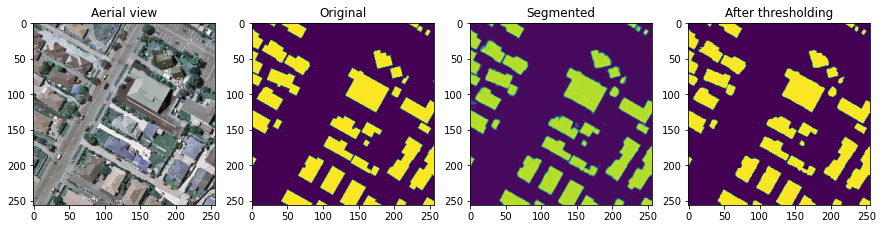

Image number: 18
IOU Score: 0.9499887824058533 
Dice Coefficent: 0.9743523597717285 
MCC: 0.9651668667793274


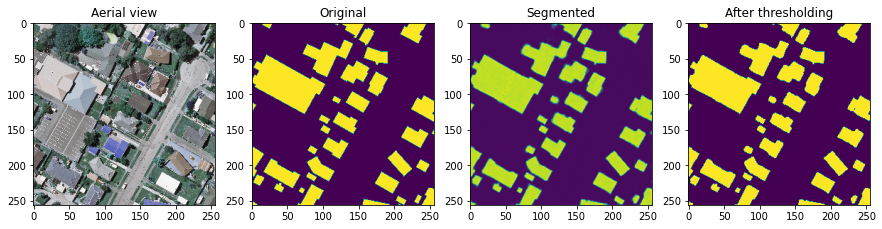

Image number: 19
IOU Score: 0.9439914226531982 
Dice Coefficent: 0.9711880087852478 
MCC: 0.9618372321128845


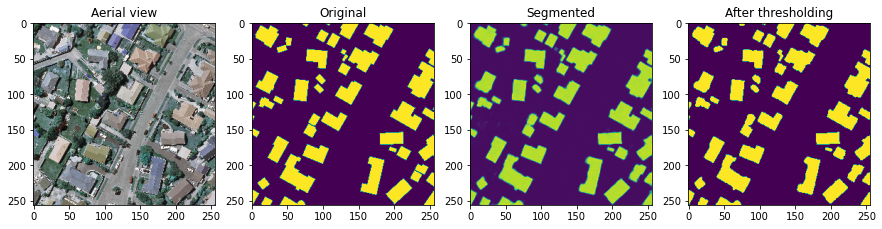

Image number: 20
IOU Score: 0.9392892122268677 
Dice Coefficent: 0.9686934351921082 
MCC: 0.9574030637741089


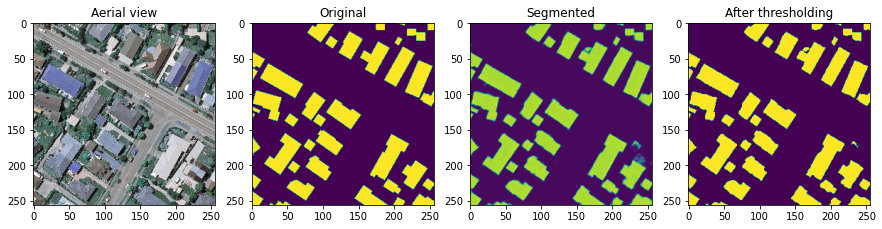

Image number: 21
IOU Score: 0.9454127550125122 
Dice Coefficent: 0.9719398021697998 
MCC: 0.9607241153717041


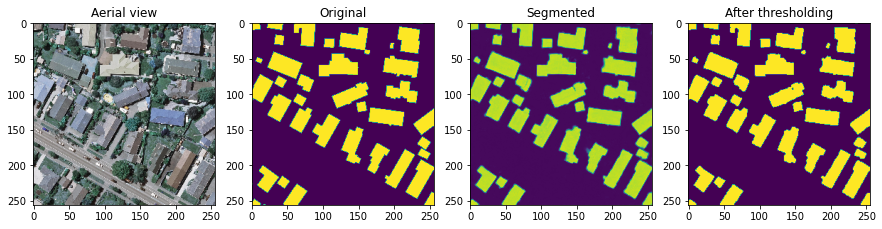

Image number: 22
IOU Score: 0.9519890546798706 
Dice Coefficent: 0.975403368473053 
MCC: 0.9664713740348816


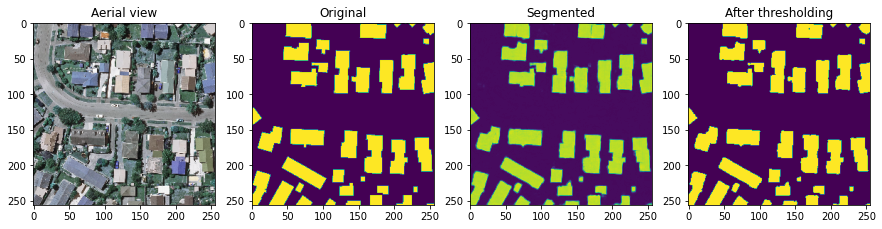

Image number: 23
IOU Score: 0.9358506202697754 
Dice Coefficent: 0.9668616652488708 
MCC: 0.9516699910163879


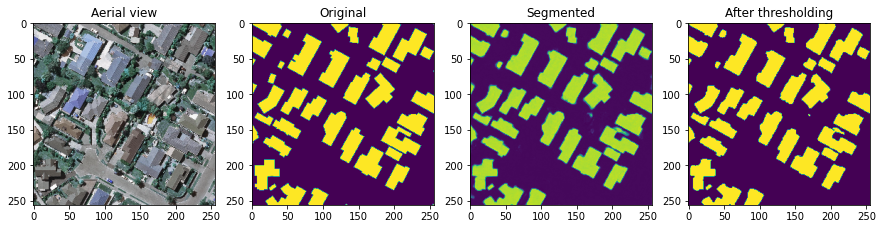

Image number: 24
IOU Score: 0.939833402633667 
Dice Coefficent: 0.9689826965332031 
MCC: 0.9586437344551086


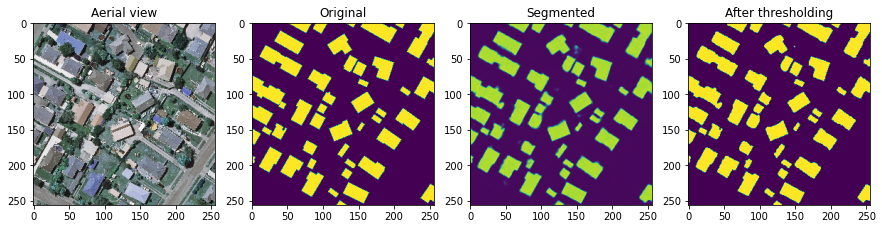

Image number: 25
IOU Score: 0.9402501583099365 
Dice Coefficent: 0.9692039489746094 
MCC: 0.9616079330444336


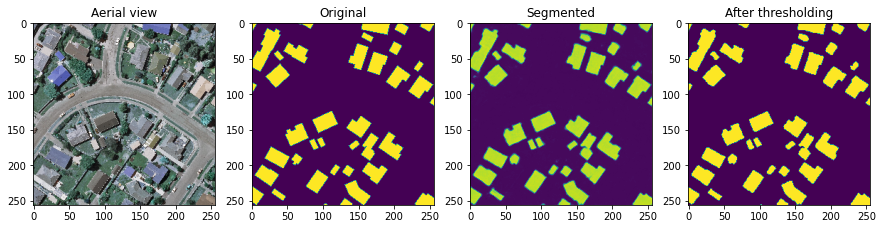

Image number: 26
IOU Score: 0.9341234564781189 
Dice Coefficent: 0.9659388661384583 
MCC: 0.9543179273605347


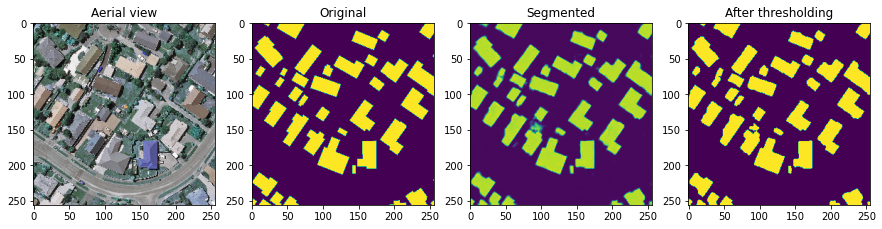

Image number: 27
IOU Score: 0.953183650970459 
Dice Coefficent: 0.9760300517082214 
MCC: 0.9674212336540222


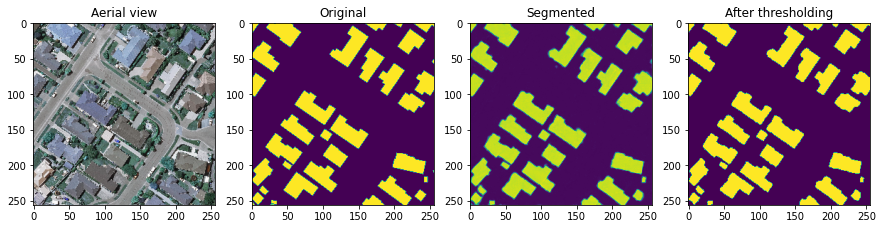

Image number: 28
IOU Score: 0.9458569884300232 
Dice Coefficent: 0.9721745252609253 
MCC: 0.9596988558769226


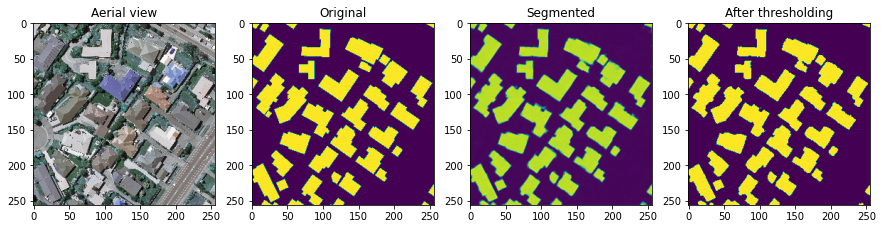

Image number: 29
IOU Score: 0.9507560729980469 
Dice Coefficent: 0.9747556447982788 
MCC: 0.9675284624099731


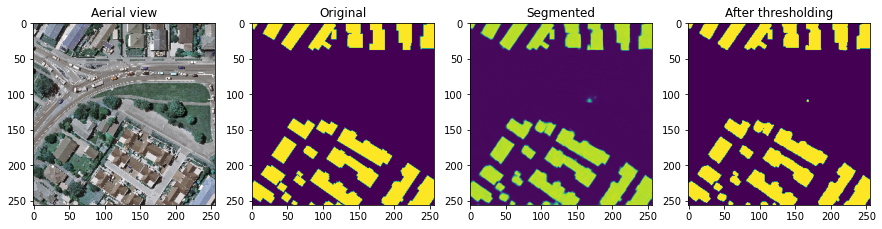

Image number: 30
IOU Score: 0.9404729008674622 
Dice Coefficent: 0.9693225026130676 
MCC: 0.958466112613678


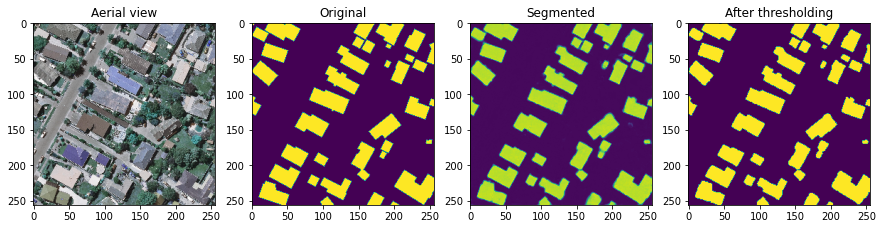

Image number: 31
IOU Score: 0.9396142959594727 
Dice Coefficent: 0.9688661098480225 
MCC: 0.9598971605300903


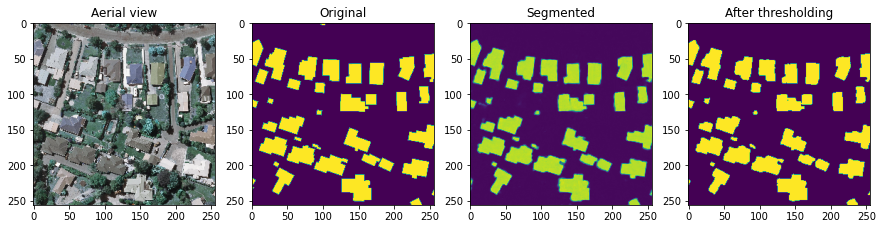

Image number: 32
IOU Score: 0.9442782402038574 
Dice Coefficent: 0.9713398814201355 
MCC: 0.9597562551498413


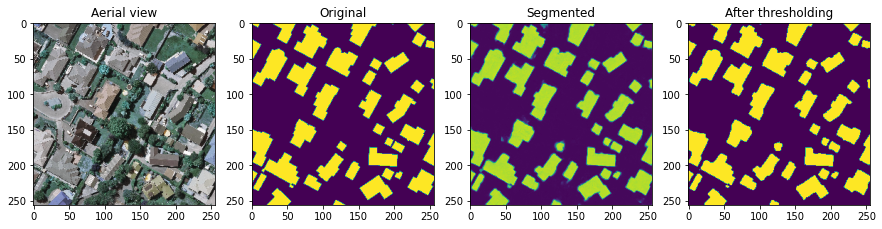

Image number: 33
IOU Score: 0.9400302767753601 
Dice Coefficent: 0.9690873026847839 
MCC: 0.9592264294624329


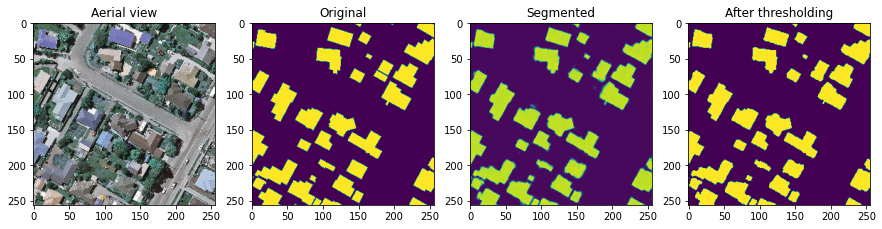

Image number: 34
IOU Score: 0.9486427903175354 
Dice Coefficent: 0.9736438989639282 
MCC: 0.9638797044754028


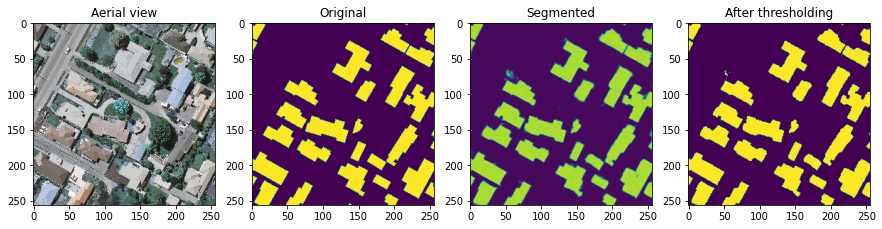

Image number: 35
IOU Score: 0.9354921579360962 
Dice Coefficent: 0.9666702151298523 
MCC: 0.9533882737159729


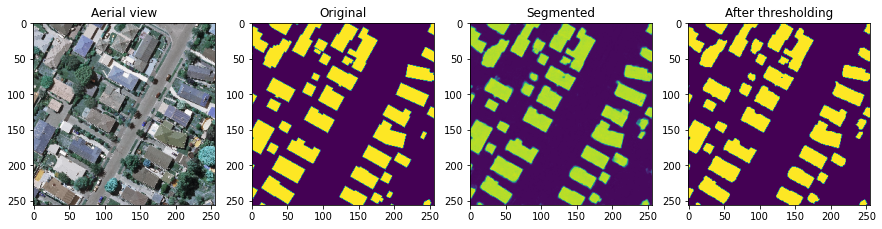

In [ ]:
rows = 36
columns = 4
count = 1
x_crops_pred = []
x_crops_actual = []
for image_number in range(0, 36):

  fig = plt.figure(figsize=(15,15))
  print('Image number: {0}'.format(image_number))
  pred_y = MultiResModel_test.predict(val_X[image_number:image_number+1])
  pred_y_thresholded = (pred_y[0,:,:,0]>0.5)

  fig.add_subplot(rows, columns, count)
  plt.subplot(1,4,1)
  plt.imshow(np.squeeze(val_X[image_number:image_number+1]))
  plt.title('Aerial view')

  fig.add_subplot(rows, columns, count+1)
  plt.subplot(1,4,2)
  plt.imshow(np.squeeze(val_Y[image_number:image_number+1]))
  plt.title('Original')

  fig.add_subplot(rows, columns, count+2)
  plt.subplot(1,4,3)
  plt.imshow(np.squeeze(pred_y[0]))
  plt.title('Segmented')

  fig.add_subplot(rows, columns, count+3)
  plt.subplot(1,4,4)
  plt.imshow(np.squeeze(pred_y_thresholded))
  plt.title('After thresholding')
  count += 4

  x_crops_pred.append(pred_y_thresholded)
  x_crops_actual.append(val_Y[image_number:image_number+1][0])

  print("IOU Score: {0} \nDice Coefficent: {1} \nMCC: {2}".format(IOU(val_Y[image_number:image_number+1], pred_y), dice_coef(val_Y[image_number:image_number+1], pred_y), mcc(val_Y[image_number:image_number+1], pred_y)))

  plt.show()

Image number: 108
IOU Score: 0.9310423135757446 
Dice Coefficent: 0.9642890691757202 
MCC: 0.9471191167831421


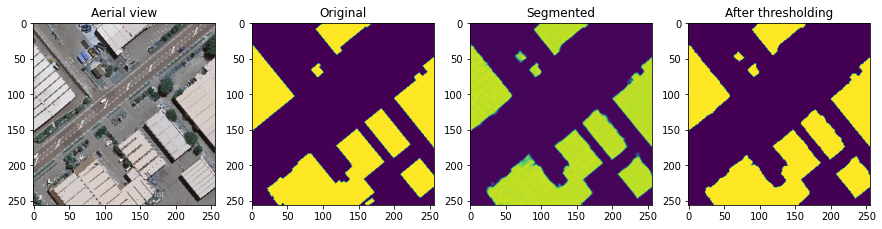

Image number: 109
IOU Score: 0.9294077157974243 
Dice Coefficent: 0.9634117484092712 
MCC: 0.9412003755569458


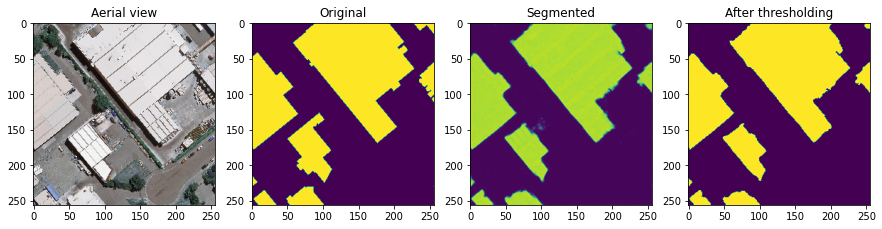

Image number: 110
IOU Score: 0.9401949048042297 
Dice Coefficent: 0.9691750407218933 
MCC: 0.9532760977745056


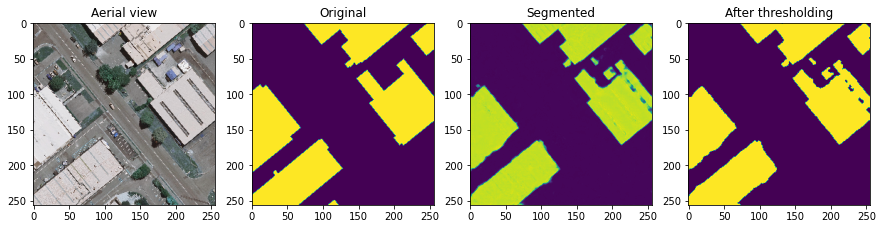

Image number: 111
IOU Score: 0.937698245048523 
Dice Coefficent: 0.9678469896316528 
MCC: 0.9450973868370056


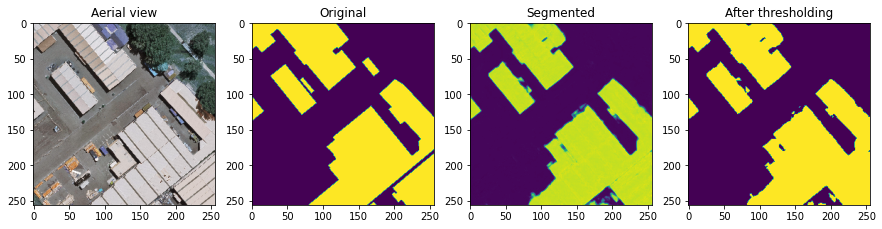

Image number: 112
IOU Score: 0.9148783683776855 
Dice Coefficent: 0.9555464386940002 
MCC: 0.922278642654419


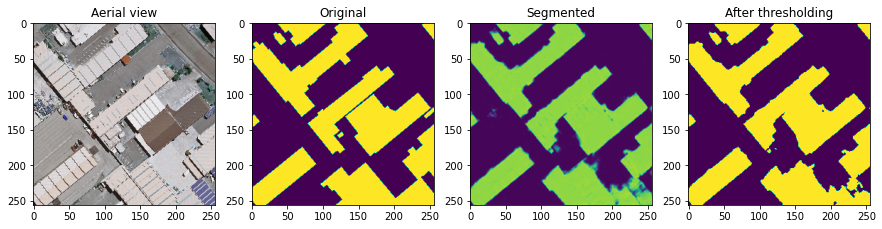

Image number: 113
IOU Score: 0.8166528940200806 
Dice Coefficent: 0.8990716338157654 
MCC: 0.8571559190750122


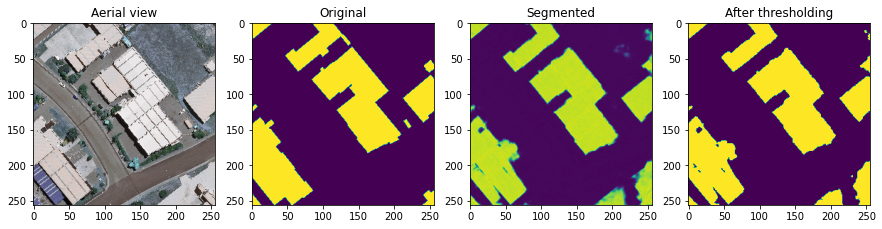

Image number: 114
IOU Score: 0.8682317733764648 
Dice Coefficent: 0.929467499256134 
MCC: 0.8904023170471191


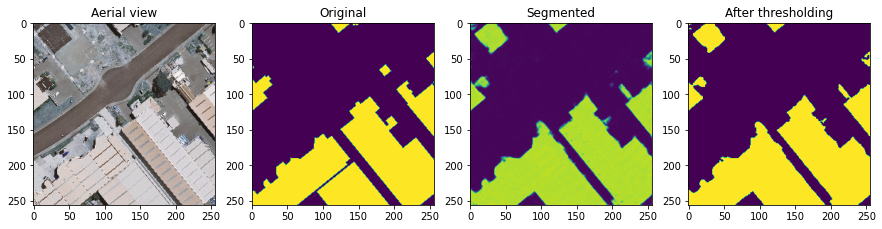

Image number: 115
IOU Score: 0.9016642570495605 
Dice Coefficent: 0.9482887387275696 
MCC: 0.9078699946403503


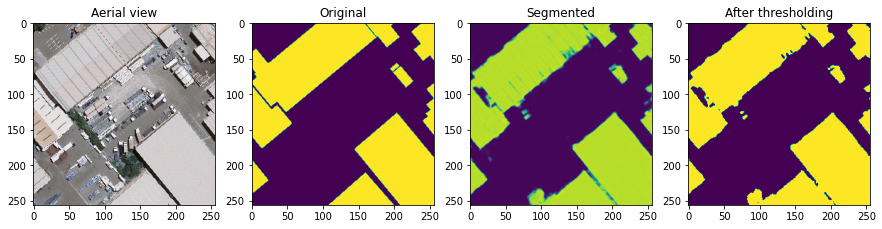

Image number: 116
IOU Score: 0.8724508881568909 
Dice Coefficent: 0.9318804144859314 
MCC: 0.8070945143699646


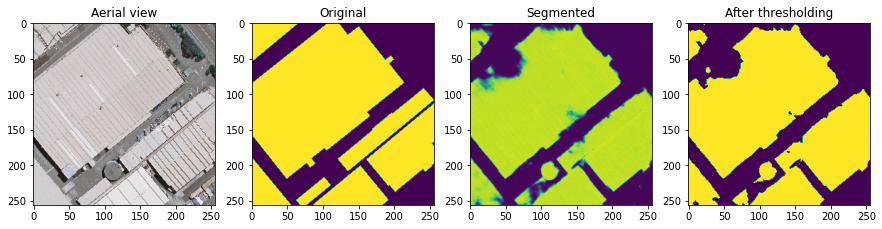

Image number: 117
IOU Score: 0.9300689101219177 
Dice Coefficent: 0.9637666344642639 
MCC: 0.9482967257499695


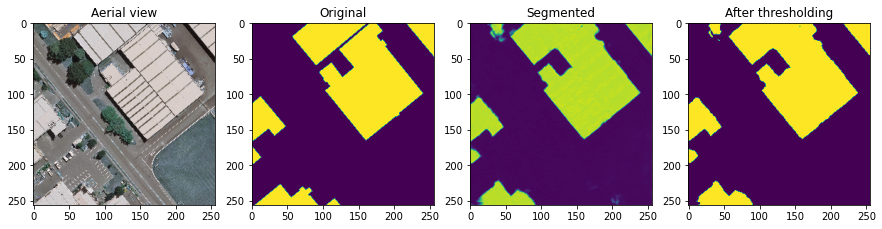

Image number: 118
IOU Score: 0.8596079349517822 
Dice Coefficent: 0.9245026111602783 
MCC: 0.8908706903457642


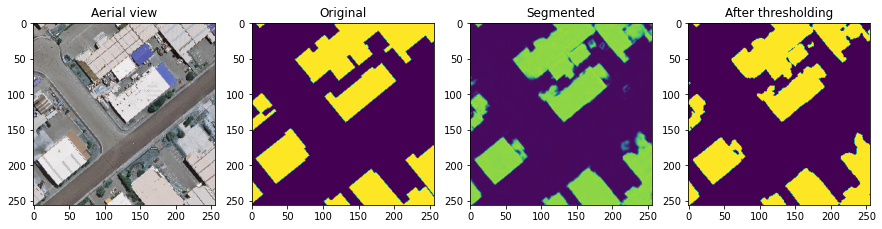

Image number: 119
IOU Score: 0.925541341304779 
Dice Coefficent: 0.9613305330276489 
MCC: 0.9180058836936951


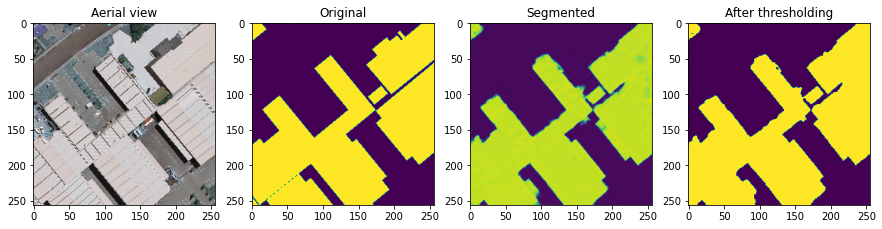

Image number: 120
IOU Score: 0.938710629940033 
Dice Coefficent: 0.9683860540390015 
MCC: 0.9374560117721558


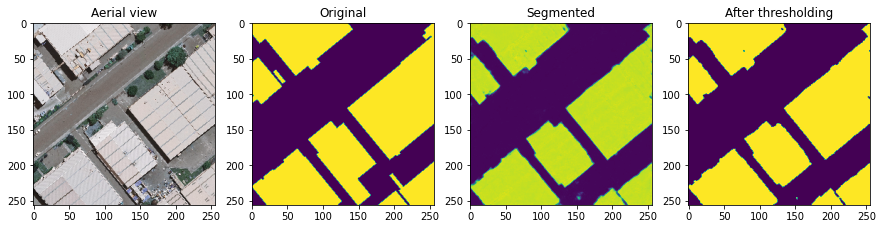

Image number: 121
IOU Score: 0.9577370882034302 
Dice Coefficent: 0.9784119725227356 
MCC: 0.9651000499725342


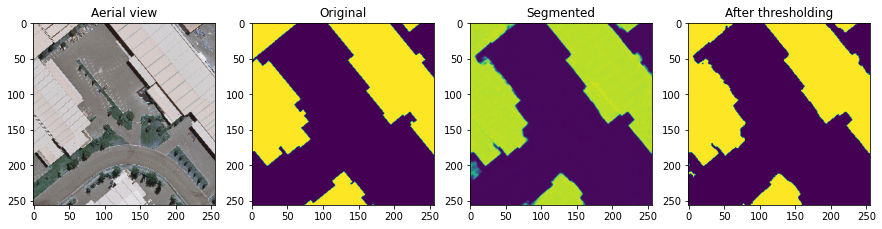

Image number: 122
IOU Score: 0.9051839709281921 
Dice Coefficent: 0.950231671333313 
MCC: 0.9177636504173279


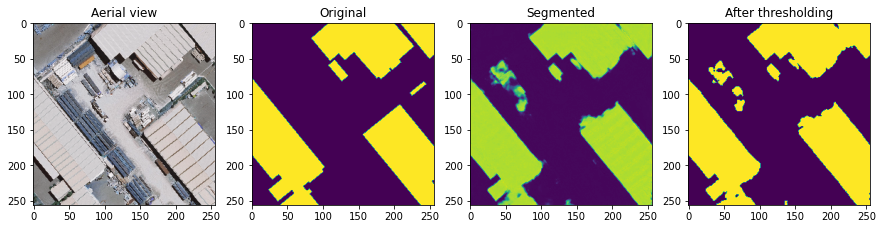

Image number: 123
IOU Score: 0.8601769208908081 
Dice Coefficent: 0.9248318076133728 
MCC: 0.884793221950531


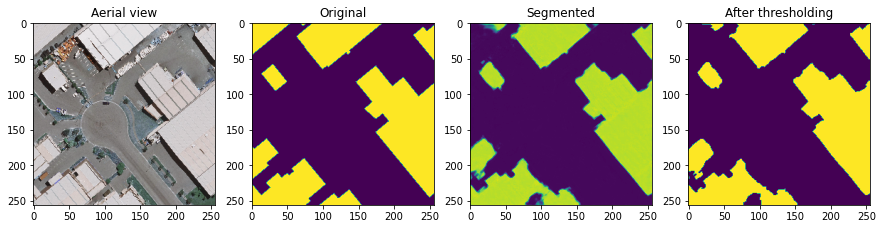

Image number: 124
IOU Score: 0.9406388401985168 
Dice Coefficent: 0.96941077709198 
MCC: 0.9562222361564636


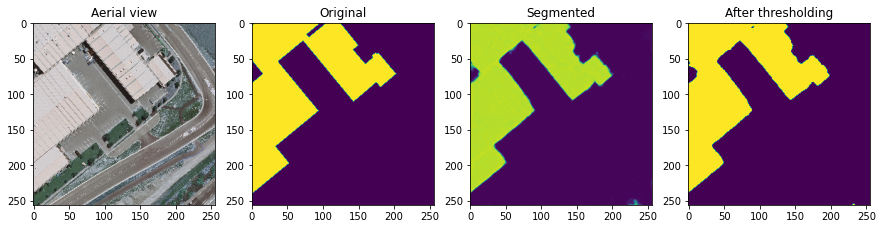

Image number: 125
IOU Score: 0.9122436046600342 
Dice Coefficent: 0.954107403755188 
MCC: 0.9135257005691528


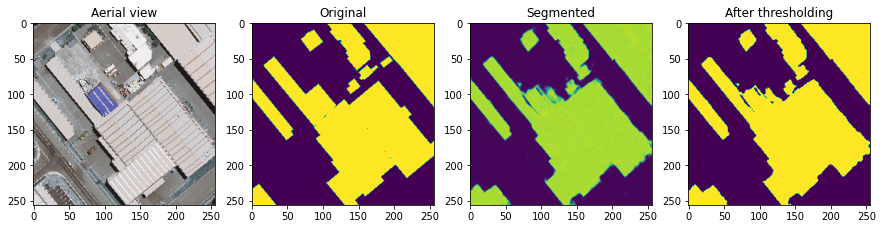

Image number: 126
IOU Score: 0.948944628238678 
Dice Coefficent: 0.9738031625747681 
MCC: 0.9511263966560364


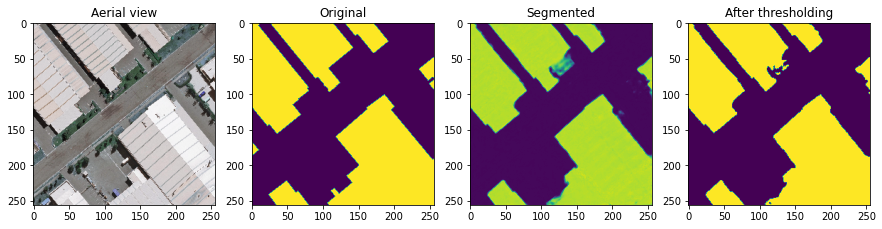

Image number: 127
IOU Score: 0.9485461115837097 
Dice Coefficent: 0.9735934138298035 
MCC: 0.9315251111984253


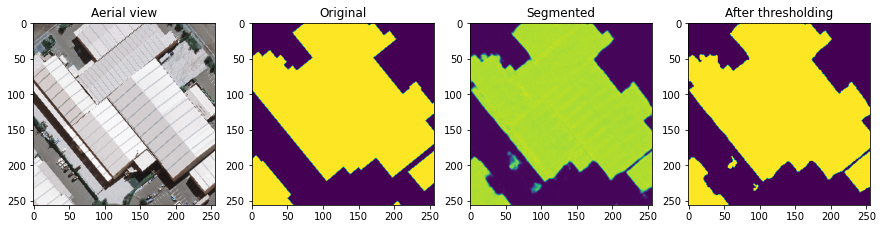

Image number: 128
IOU Score: 0.8799878358840942 
Dice Coefficent: 0.9361620545387268 
MCC: 0.8987259864807129


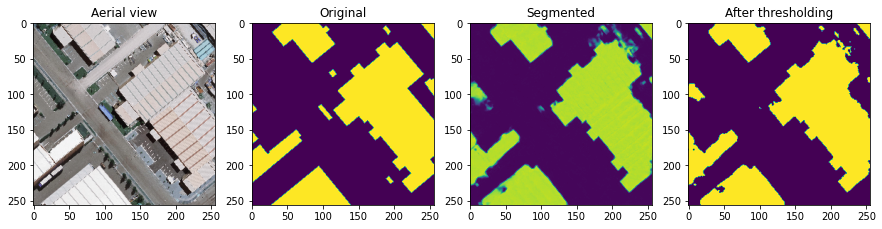

Image number: 129
IOU Score: 0.9114775061607361 
Dice Coefficent: 0.9536875486373901 
MCC: 0.9385601878166199


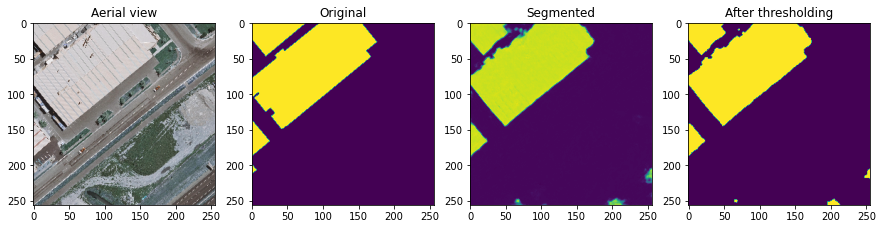

Image number: 130
IOU Score: 0.3333333432674408 
Dice Coefficent: 0.3333333432674408 
MCC: 1.0


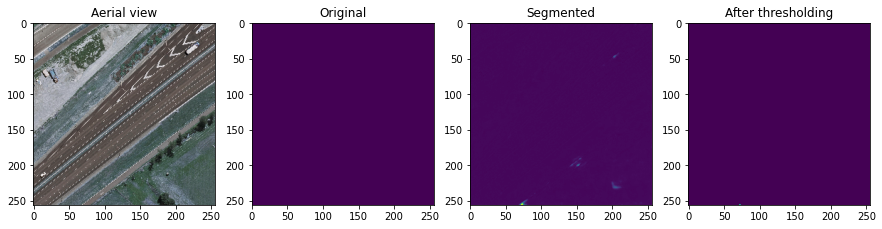

Image number: 131
IOU Score: 0.9130098819732666 
Dice Coefficent: 0.9545262455940247 
MCC: 0.9254119992256165


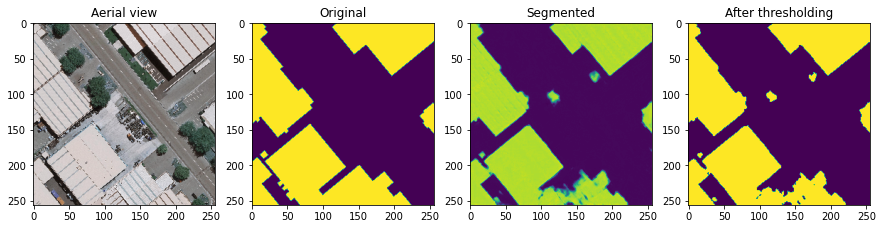

Image number: 132
IOU Score: 0.652737021446228 
Dice Coefficent: 0.7898732423782349 
MCC: 0.770756185054779


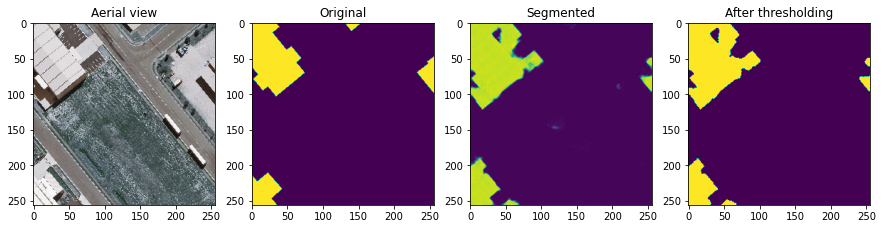

Image number: 133
IOU Score: 0.9614609479904175 
Dice Coefficent: 0.9803516268730164 
MCC: 0.9526517391204834


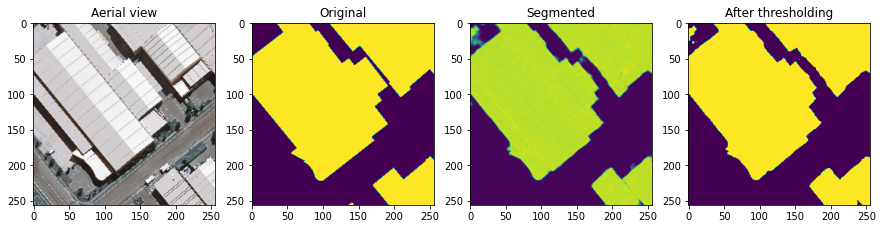

Image number: 134
IOU Score: 0.921420156955719 
Dice Coefficent: 0.9591023921966553 
MCC: 0.9352115988731384


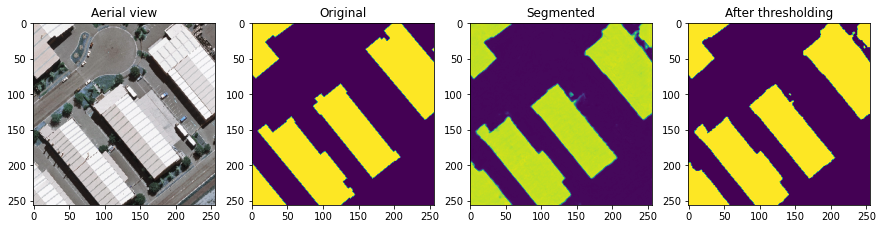

Image number: 135
IOU Score: 0.9326549172401428 
Dice Coefficent: 0.9651523232460022 
MCC: 0.9591166377067566


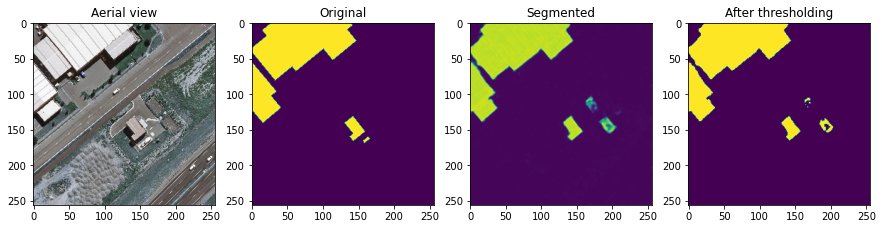

Image number: 136
IOU Score: 1.0 
Dice Coefficent: 1.0 
MCC: 1.0


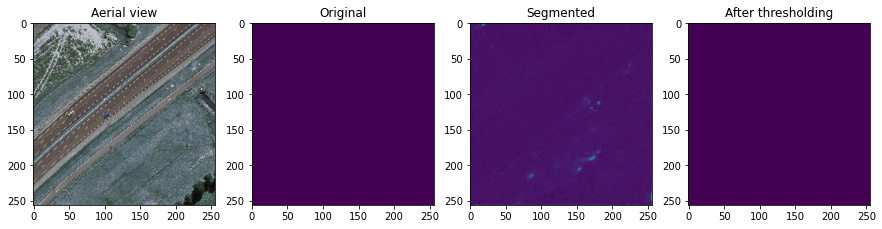

Image number: 137
IOU Score: 1.0 
Dice Coefficent: 1.0 
MCC: 1.0


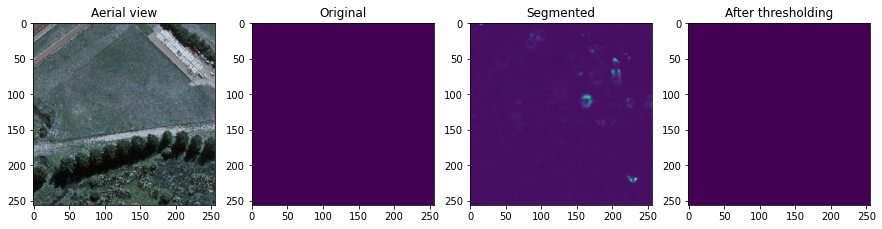

Image number: 138
IOU Score: 0.8904238939285278 
Dice Coefficent: 0.9420351982116699 
MCC: 0.8958531618118286


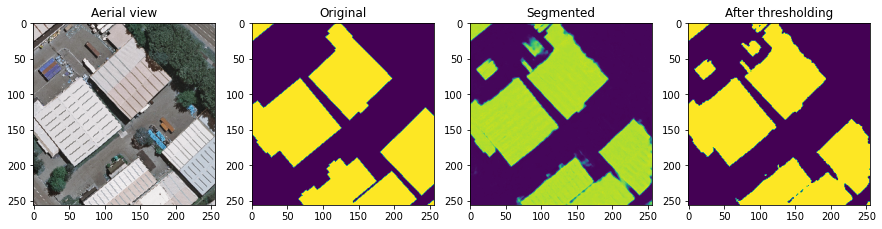

Image number: 139
IOU Score: 0.7986454367637634 
Dice Coefficent: 0.8880407214164734 
MCC: 0.8790351152420044


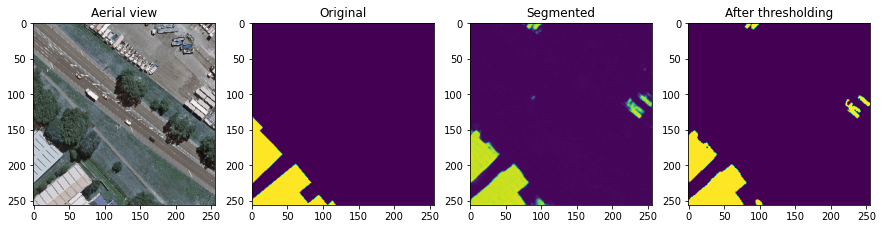

Image number: 140
IOU Score: 0.8627981543540955 
Dice Coefficent: 0.9263439178466797 
MCC: 0.9045180082321167


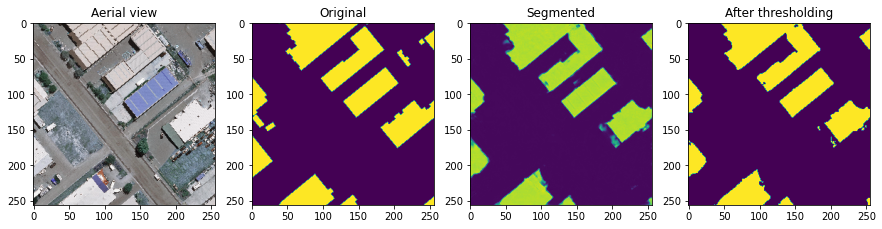

Image number: 141
IOU Score: 0.830899178981781 
Dice Coefficent: 0.9076369404792786 
MCC: 0.886281430721283


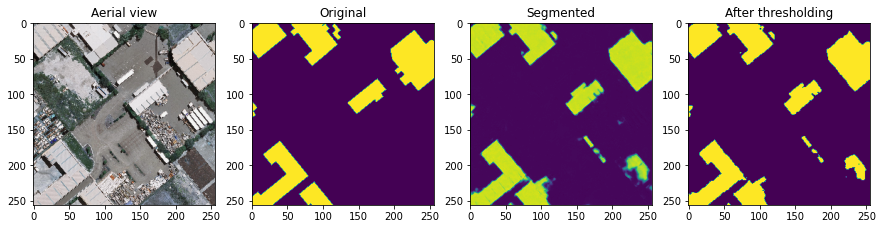

Image number: 142
IOU Score: 0.9235052466392517 
Dice Coefficent: 0.9602309465408325 
MCC: 0.9247197508811951


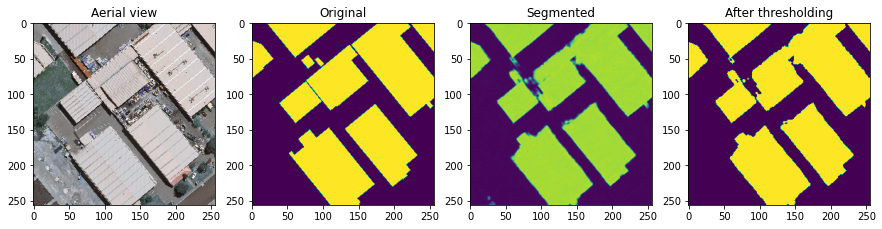

Image number: 143
IOU Score: 0.9312618374824524 
Dice Coefficent: 0.9644069671630859 
MCC: 0.9423043727874756


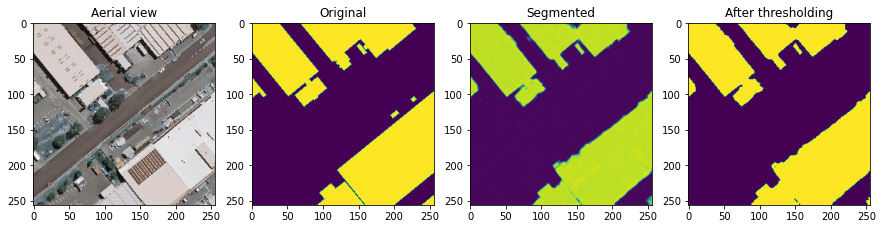

In [14]:
rows = 36
columns = 4
count = 1
for image_number in range(108, 144):

  fig = plt.figure(figsize=(15,15))
  print('Image number: {0}'.format(image_number))
  pred_y = MultiResModel_test.predict(test_X[image_number:image_number+1])

  fig.add_subplot(rows, columns, count)
  plt.subplot(1,4,1)
  plt.imshow(np.squeeze(test_X[image_number:image_number+1]))
  plt.title('Aerial view')

  fig.add_subplot(rows, columns, count+1)
  plt.subplot(1,4,2)
  plt.imshow(np.squeeze(test_Y[image_number:image_number+1]))
  plt.title('Original')

  fig.add_subplot(rows, columns, count+2)
  plt.subplot(1,4,3)
  plt.imshow(np.squeeze(pred_y[0]))
  plt.title('Segmented')

  pred_y_thresholded = (pred_y[0,:,:,0]>0.5)
  fig.add_subplot(rows, columns, count+3)
  plt.subplot(1,4,4)
  plt.imshow(np.squeeze(pred_y_thresholded))
  plt.title('After thresholding')
  count += 4

  print("IOU Score: {0} \nDice Coefficent: {1} \nMCC: {2}".format(IOU(test_Y[image_number:image_number+1], pred_y), dice_coef(test_Y[image_number:image_number+1], pred_y), mcc(test_Y[image_number:image_number+1], pred_y)))

  plt.show()

Text(0.5, 1.0, 'After thresholding')

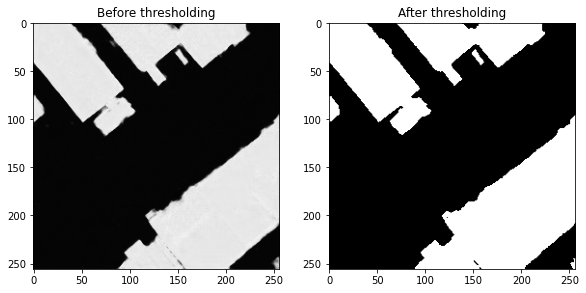

In [ ]:
pred_y.shape
pred_y_thresholded = (pred_y[0,:,:,0]>0.5)
pred_y_thresholded.shape

fig = plt.figure(figsize=(15,15))

fig.add_subplot(1, 2, 1)
plt.subplot(1,3,1)
plt.imshow(np.squeeze(pred_y[0]), cmap = 'gray')
plt.title('Before thresholding')

plt.subplot(1,3,2)
plt.imshow(np.squeeze(pred_y_thresholded), cmap = 'gray')
plt.title('After thresholding')

### **Patching all images**

In [ ]:
def reconstruct_from_patches(img_arr, org_img_size, stride=None, size=None):
    """[summary]
    
    Args:
        img_arr (numpy.ndarray): [description]
        org_img_size (tuple): [description]
        stride ([type], optional): [description]. Defaults to None.
        size ([type], optional): [description]. Defaults to None.
    
    Raises:
        ValueError: [description]
    
    Returns:
        numpy.ndarray: [description]
    """
    # check parameters
    if type(org_img_size) is not tuple:
        raise ValueError("org_image_size must be a tuple")

    if img_arr.ndim == 3:
        img_arr = np.expand_dims(img_arr, axis=0)

    if size is None:
        size = img_arr.shape[1]

    if stride is None:
        stride = size

    nm_layers = img_arr.shape[3]

    i_max = (org_img_size[0] // stride) + 1 - (size // stride)
    j_max = (org_img_size[1] // stride) + 1 - (size // stride)

    total_nm_images = img_arr.shape[0] // (i_max ** 2)
    nm_images = img_arr.shape[0]

    averaging_value = size // stride
    images_list = []
    kk = 0
    for img_count in range(total_nm_images):
        img_bg = np.zeros(
            (org_img_size[0], org_img_size[1], nm_layers), dtype=img_arr[0].dtype
        )

        for i in range(i_max):
            for j in range(j_max):
                for layer in range(nm_layers):
                    img_bg[
                        i * stride : i * stride + size,
                        j * stride : j * stride + size,
                        layer,
                    ] = img_arr[kk, :, :, layer]

                kk += 1
        # TODO add averaging for masks - right now it's just overwritting

        #         for layer in range(nm_layers):
        #             # average some more because overlapping 4 patches
        #             img_bg[stride:i_max*stride, stride:i_max*stride, layer] //= averaging_value
        #             # corners:
        #             img_bg[0:stride, 0:stride, layer] *= averaging_value
        #             img_bg[i_max*stride:i_max*stride+stride, 0:stride, layer] *= averaging_value
        #             img_bg[i_max*stride:i_max*stride+stride, i_max*stride:i_max*stride+stride, layer] *= averaging_value
        #             img_bg[0:stride, i_max*stride:i_max*stride+stride, layer] *= averaging_value

        images_list.append(img_bg)

    return np.stack(images_list)


In [ ]:
x_crops_pred = np.stack(x_crops_pred)
x_crops_actual = np.stack(x_crops_actual)
print(x_crops_pred.shape, type(x_crops_pred), x_crops_actual.shape)

x_crops_pred_2 = np.reshape(x_crops_pred, x_crops_pred.shape + (1,))
x_crops_actual_2 = x_crops_actual
# x_crops_actual_2 = np.reshape(x_crops_actual, x_crops_actual.shape + (1,))
print(x_crops_pred_2.shape, x_crops_actual_2.shape)

(36, 256, 256) <class 'numpy.ndarray'> (36, 256, 256, 1)
(36, 256, 256, 1) (36, 256, 256, 1)


x_crops shape:  (36, 256, 256, 1)
x_reconstructed shape:  (1, 1536, 1536, 1)
x_reconstructed shape:  (1, 1536, 1536, 1)


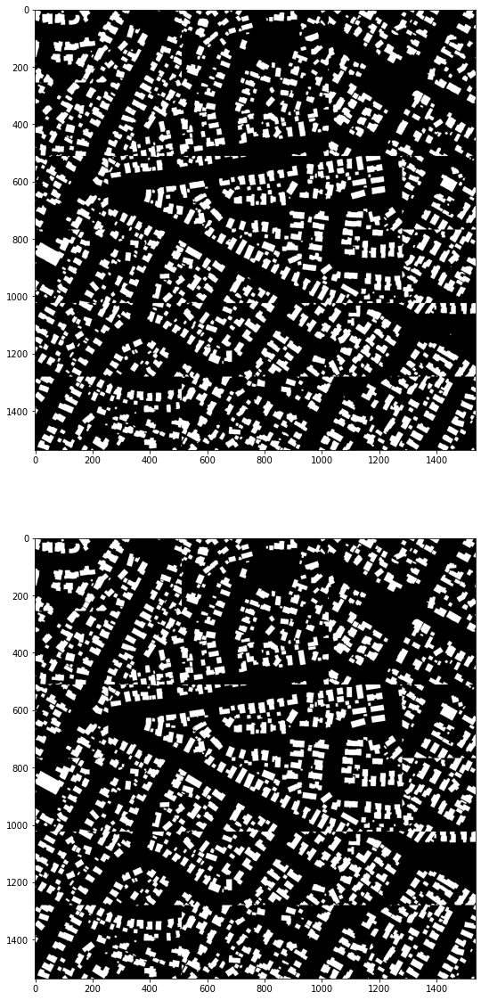

In [ ]:
print("x_crops shape: ", str(x_crops_pred_2.shape))

x_reconstructed_pred = reconstruct_from_patches(
    img_arr=x_crops_pred_2, # required - array of cropped out images
    org_img_size=(1536, 1536), # required - original size of the image
    stride=256) # use only if stride is different from patch size

print("x_reconstructed shape: ", str(x_reconstructed_pred.shape))

x_reconstructed_actual = reconstruct_from_patches(
    img_arr=x_crops_actual_2, # required - array of cropped out images
    org_img_size=(1536, 1536), # required - original size of the image
    stride=256) # use only if stride is different from patch size

print("x_reconstructed shape: ", str(x_reconstructed_actual.shape))

fig = plt.figure(figsize=(20,20))

fig.add_subplot(3,1,1)
# plt.subplot(1,2,1)
plt.imshow(np.squeeze(x_reconstructed_pred[0]), cmap = 'gray')
# plt.show()

fig.add_subplot(3,1,2)
# plt.subplot(1,2,2)
plt.imshow(np.squeeze(x_reconstructed_actual[0]), cmap = 'gray')
# plt.show()

fig.add_subplot(3,1,3)
# plt.subplot(1,2,2)
plt.imshow(np.squeeze(x_reconstructed_actual[0]), cmap = 'gray')